In [1]:
import os
import sys
import cv2
from ffmpeg import input, output
import math
import glob
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Image

from zipfile import ZipFile
from urllib.request import urlretrieve
from IPython.display import HTML
from matplotlib.animation import FuncAnimation

from IPython.display import YouTubeVideo, display, HTML
from base64 import b64encode

matplotlib.rcParams['figure.figsize'] = (9.0, 9.0)

%matplotlib inline

Define download and unzip function

In [2]:
def download_and_unzip(url, save_path):
    print(f"Downloading and extracting assests....", end="")

    # Downloading zip file using urllib package.
    urlretrieve(url, save_path)

    try:
        # Extracting zip file using the zipfile package.
        with ZipFile(save_path) as z:
            # Extract ZIP file contents in the same directory.
            z.extractall(os.path.split(save_path)[0])

        print("Done")

    except Exception as e:
        print("\nInvalid file.", e)

In [3]:
URL = r"https://www.dropbox.com/s/qhhlqcica1nvtaw/opencv_bootcamp_assets_NB1.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB1.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

In [8]:
Image(filename="checkerboard_18x18.png")

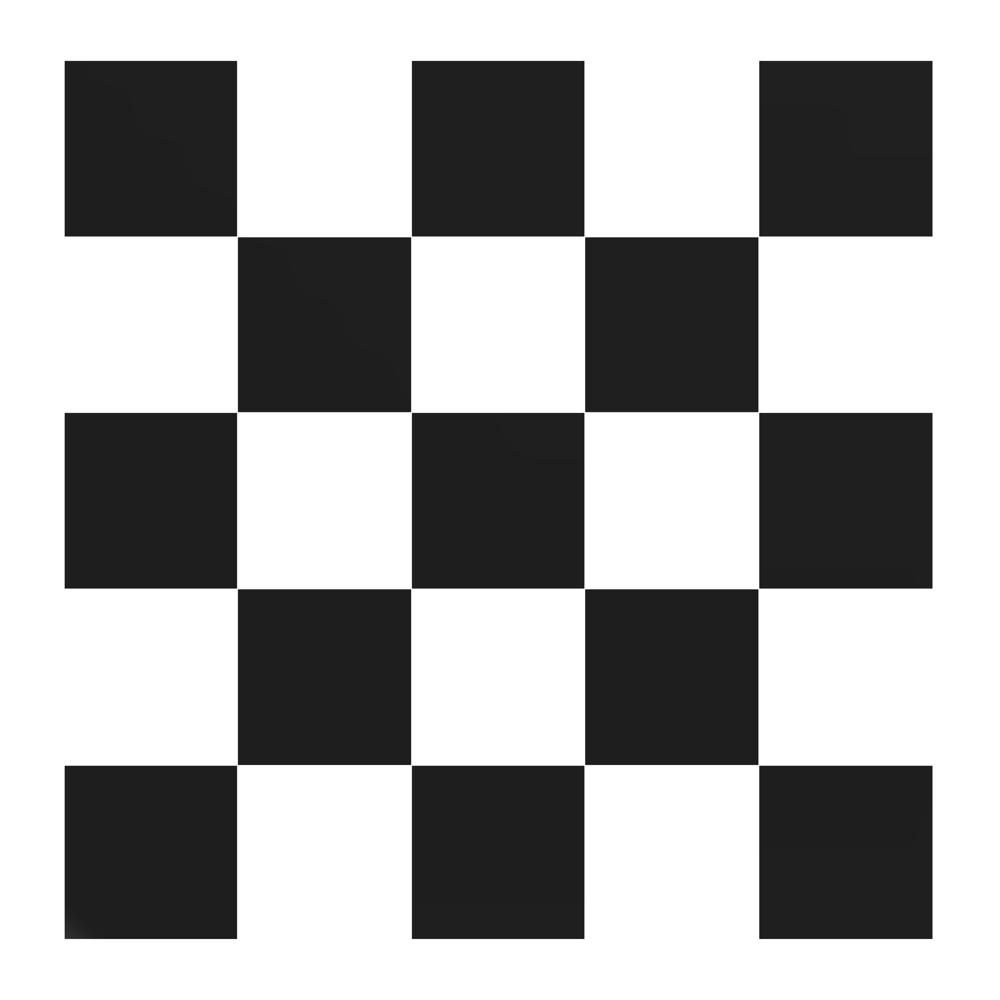

In [9]:
Image(filename="—Pngtree—checkerboard clipart check chess game_6166270.png")

<span style="font-weight: bold; font-size: 30px;">Reading Images Using OpenCV</span>

<div>
OpenCV allows reading different types of images (JPG, PNG, etc). You can load grayscale images, color images, or even images with an alpha channel. It uses the 
<span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">cv2.imread()</span> function, which has the following syntax:
</div>

<span style="color: green; font-size: 25px;">Function Syntax</span>
<div>
    <div>retval = cv2.imread( filename[, flags] )</div>
    <span style="background-color: #d3d3d3; padding: 2px;">retval:</span> This is the image if it is successfully loaded. Otherwise, it is <span style="font-weight: bold;">None</span>. This may happen if the filename is wrong or the file is corrupt.
</div>

The function has <span style="font-weight: bold;">1 required input argument</span> and one optional flag:

- <span style="font-weight: bold;">filename:</span> This can be an absolute or relative path. This is a mandatory argument.
- <span style="font-weight: bold;">flags:</span> These flags are used to read an image in a particular format (e.g., grayscale/color/with alpha channel). This is an optional argument with a default value of `cv2.IMREAD_COLOR` (or `1`), which loads the image as a color image.

Before we proceed with some examples, let's also have a look at some of the flags available.

<span style="font-weight: bold; font-size: 24px;">Flags</span>
<ul>
    <li style="margin: 4px;">
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">cv2.IMREAD_GRAYSCALE</span> 
        or 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">0</span>: Loads the image in grayscale mode.
    </li>
    <li style="margin: 4px;">
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">cv2.IMREAD_COLOR</span> 
        or 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">1</span>: Loads a color image. Any transparency in the image will be neglected. It is the default flag.
    </li>
    <li style="margin: 4px;">
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">cv2.IMREAD_UNCHANGED</span> 
        or 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">-1</span>: Loads the image as-is, including the alpha channel.
    </li>
</ul>

<span style="font-weight: bold;">OpenCV Documentation</span>
<ul>
    <li>
        <a href="https://docs.opencv.org/4.5.1/d4/da8/group__imgcodecs.html#ga288b8b3da0892bd651fce07b3bbd3a56" target="_blank">Imread</a>
    </li>
    <li>
        <a href="https://docs.opencv.org/4.5.1/d8/d6a/group__imgcodecs__flags.html#ga61d9b0126a3e57d9277ac48327799c80" target="_blank">ImreadModes</a>
    </li>
</ul>


In [15]:
cb_image = cv2.imread("checkerboard_18x18.png", 0)
print(cb_image)

[[[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [255 255 255]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]]

 [[  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [  0   0   0]
  [255 255 255]
  [255 255 255]
  

<span style="font-weight: bold; font-size: 25px;">Get Image Attribute</span>

In [16]:
print("Image size is: ", cb_image.shape)
print("Data type of image is: ", cb_image.dtype)

Image size is:  (18, 18, 3)
Data type of image is:  uint8


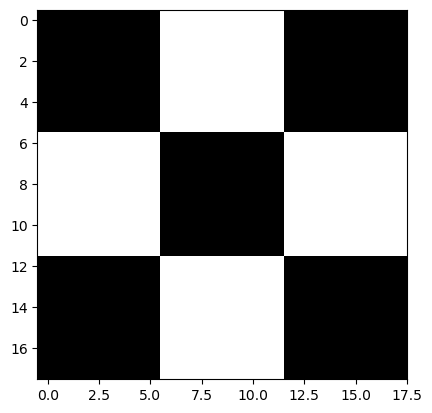

In [17]:
plt.imshow(cb_image)

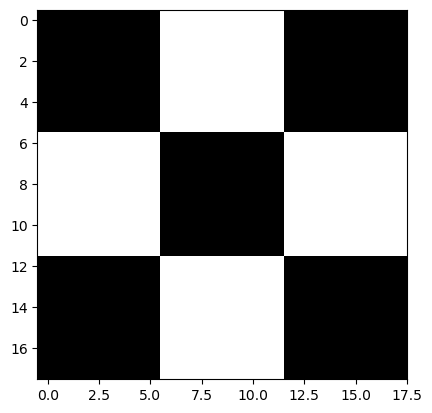

In [18]:
plt.imshow(cb_image, cmap='gray')

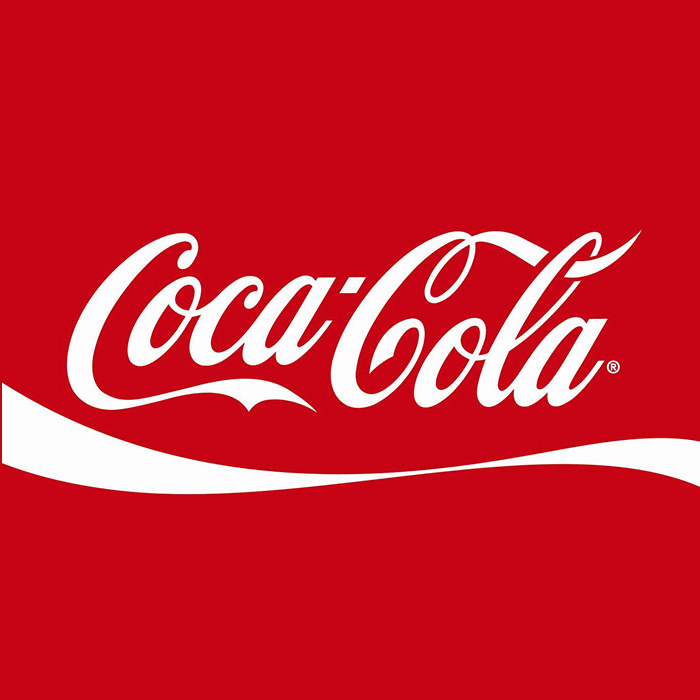

In [19]:
Image('coca-cola-logo.png')

In [20]:
coke_img = cv2.imread('coca-cola-logo.png', 1) #flag = 1 -> colored image

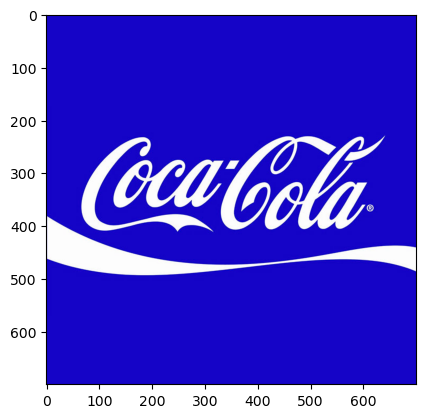

In [21]:
plt.imshow(coke_img)

The color displayed above is different from the actual image. This is because matplotlib expects the image in RGB format whereas OpenCV stores images in BGR format. Thus, for correct display, we need to reverse the channels of the image. We will discuss about the channels in the sections below.

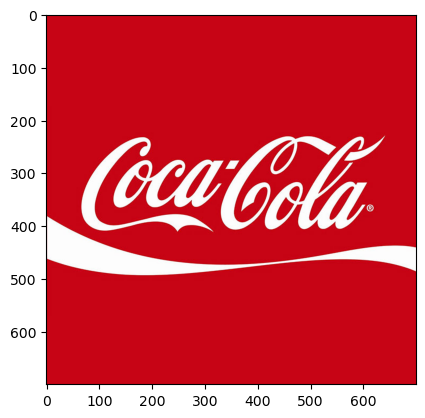

In [23]:
coke_image_reversed = coke_img[:,:,::-1]
plt.imshow(coke_image_reversed)

<span style="font-weight: bold; font-size: 30px;">Splitting and Merging Color Channels</span>

<ul>
    <li>
        <span style="font-weight: bold; background-color: #d3d3d3; padding: 2px;">cv2.split()</span> Divides a multi-channel array into several single-channel arrays.
    </li>
    <li>
        <span style="font-weight: bold; background-color: #d3d3d3; padding: 2px;">cv2.merge()</span> Merges several arrays to make a single multi-channel array. All the input matrices must have the same size.
    </li>
</ul>
<span style="color: green; font-size: 25px;">OpenCV Documentation</span>
<div>
<a href="https://docs.opencv.org/4.5.1/d2/de8/group__core__array.html#ga0547c7fed86152d7e9d0096029c8518a">Document link</a>
</div>

Text(0.5, 1.0, 'Merged output')

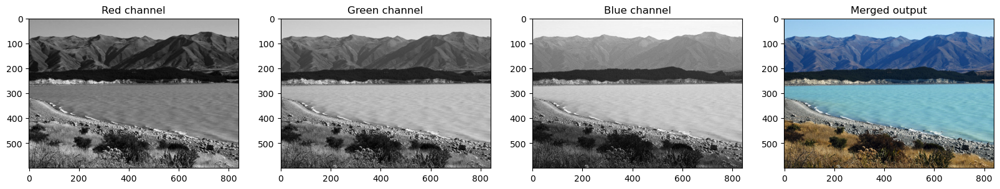

In [28]:
#Split the image into B,G,R components
image_split = cv2.imread("New_Zealand_Lake.jpg", 1)
b, g, r = cv2.split(image_split)

#Show the channels
plt.figure(figsize=[20,5])
plt.subplot(141);plt.imshow(r, cmap='gray'); plt.title("Red channel")
plt.subplot(142);plt.imshow(g, cmap='gray'); plt.title("Green channel")
plt.subplot(143);plt.imshow(b, cmap='gray'); plt.title("Blue channel")

# Merge channels together to create BGR image
imgMerged = cv2.merge((b,g,r))
plt.subplot(144);plt.imshow(imgMerged[:,:,::-1]); plt.title("Merged output") # change from bgr to rgb
# we can use merge((r,g,b)) to get the target rgb image to show instead, but it is not good practice because we are now consider
# it as the result of cv2.imread which is BGR image

<span style="font-weight: bold; font-size: 25px;">Convert to different color spaces</span>

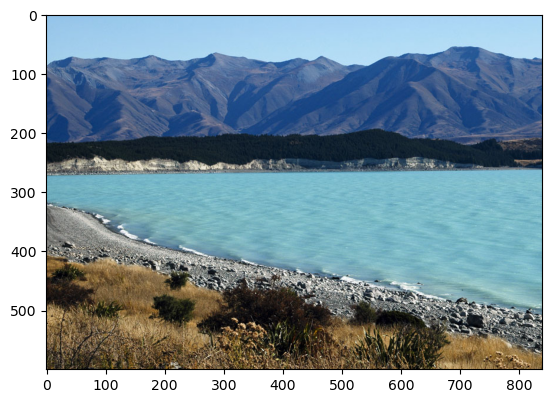

In [29]:
img_rgb = cv2.cvtColor(image_split, cv2.COLOR_BGR2RGB) # convert BGR to RGB
plt.imshow(img_rgb)

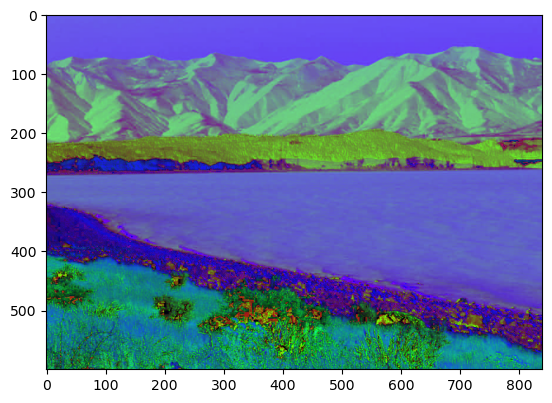

In [30]:
img_hsv = cv2.cvtColor(image_split, cv2.COLOR_BGR2HSV) # convert BGR to HSV
plt.imshow(img_hsv)

Text(0.5, 1.0, 'Original image')

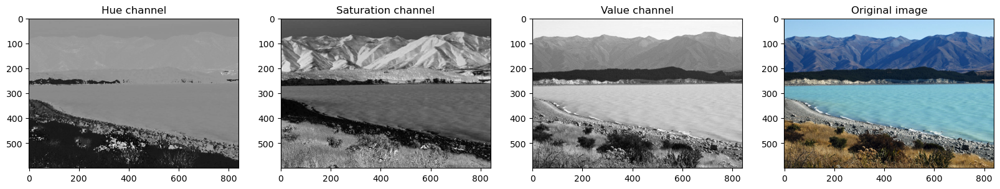

In [34]:
h,s,v = cv2.split(img_hsv)

#Show the channels
plt.figure(figsize=[20,5])
plt.subplot(141);plt.imshow(h, cmap='gray'); plt.title("Hue channel")
plt.subplot(142);plt.imshow(s, cmap='gray'); plt.title("Saturation channel")
plt.subplot(143);plt.imshow(v, cmap='gray'); plt.title("Value channel")

plt.subplot(144);plt.imshow(img_rgb); plt.title("Original image")

<span style="font-weight: bold; font-size: 25px;">Modifying channel</span>

Text(0.5, 1.0, 'Modified image')

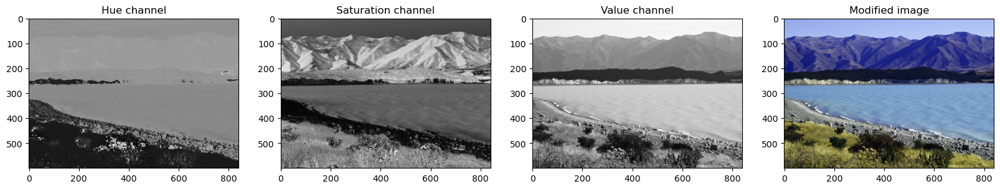

In [35]:
h_new = h+10
modified_img = cv2.merge((h_new, s, v))
modified_rgb = cv2.cvtColor(modified_img, cv2.COLOR_HSV2RGB)

#Show the channels
plt.figure(figsize=[20,5])
plt.subplot(141);plt.imshow(h, cmap='gray'); plt.title("Hue channel")
plt.subplot(142);plt.imshow(s, cmap='gray'); plt.title("Saturation channel")
plt.subplot(143);plt.imshow(v, cmap='gray'); plt.title("Value channel")

plt.subplot(144);plt.imshow(modified_rgb); plt.title("Modified image")

<span style="font-weight: bold; font-size: 30px;">Saving Images</span>

<div>
<p>Saving the image is as trivial as reading an image in OpenCV. We use the function
<span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">cv2.imwrite()</span> with two arguments. The first one is the filename, second argument is the image object.</p>
    <p>The function imwrite saves the image to the specified file. The image format is chosen based on the filename extension (see cv::imread for the list of extensions). In general, only 8-bit single-channel or 3-channel (with 'BGR' channel order) images can be saved using this function (see the OpenCV documentation for further details).</p>
</div>

<span style="color: green; font-size: 25px;">Function Syntax</span>

<div> <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">cv2.imwrite( filename, img[, params] )</span> </div> <div> <p>The function has <span style="font-weight: bold;">2 required arguments</span> and an optional parameter:</p> <ul> <li> <span style="font-weight: bold;">filename:</span> This is the name of the file where the image will be saved. It can be an absolute or relative path. The format of the image is inferred from the file extension (e.g., `.jpg`, `.png`). </li> <li> <span style="font-weight: bold;">img:</span> This is the image object or array to be saved. It should be a valid image object, typically loaded or created in OpenCV. </li> <li> <span style="font-weight: bold;">params (optional):</span> A list of parameters for saving the image. For example, you can specify the compression quality for JPEG images or the compression level for PNG images. This is optional and can be omitted if not needed. </li> </ul> </div>

<span style="font-weight: bold; font-size: 24px;">OpenCV Documentation</span>

<ul> <li> <a href="https://docs.opencv.org/4.5.1/d4/da8/group__imgcodecs.html#gabbc7ef1aa2edfaa87772f1202d67e0ce" target="_blank" style="color: blue; text-decoration: underline;">Imwrite</a> </li> <li> <a href="https://docs.opencv.org/4.5.1/d8/d6a/group__imgcodecs__flags.html#ga292d81be8d76901bff7988d18d2b42ac" target="_blank" style="color: blue; text-decoration: underline;">ImwriteFlags</a> </li> </ul>

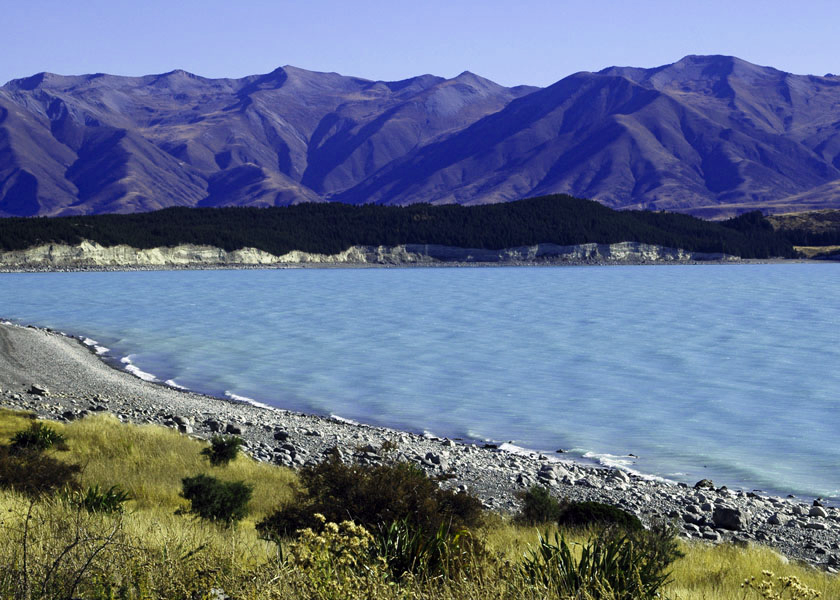

In [38]:
modified_bgr = cv2.cvtColor(modified_img, cv2.COLOR_HSV2BGR)
cv2.imwrite("modify_lake_img.png", modified_bgr)
Image("modify_lake_img.png")

<span style="font-weight: bold; font-size: 30px;">Basic Images Manipulation</span>

<span style="font-weight: bold; font-size: 25px;">Cropping Image</span>

<p>Cropping an image is simply achieved by selecting a specific (pixel) region of the image.</p>

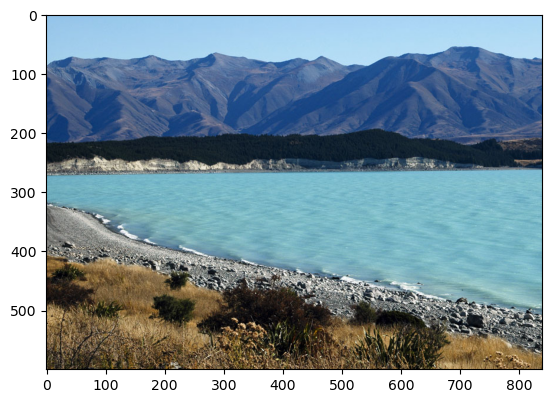

In [6]:
img_NZ_bgr = cv2.imread("New_Zealand_Lake.jpg", 1)
img_NZ_rgb = img_NZ_bgr[:,:,::-1]

plt.imshow(img_NZ_rgb)

<span style="color: green; font-size: 25px;">Crop Region</span>

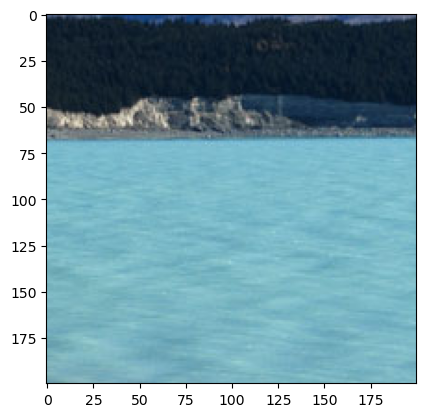

In [7]:
cropped_region = img_NZ_rgb[200:400, 300:500]
plt.imshow(cropped_region)

<span style="font-weight: bold; font-size: 25px;">Resizing Images</span>

<div>
    <p>
        The function <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">resize</span> resizes the image 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src</span> down to or up to the specified size. The size and type are derived from the 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src</span>, 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dsize</span>, 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">fx</span>, and 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">fy</span>.
    </p>
</div>

<span style="color: green; font-size: 25px;">Function Syntax</span>

<div>
    <p>
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dst = resize( src, dsize[, dst[, fx[, fy[, interpolation]]]] )</span>
    </p>
    <p>
        <span style="font-weight: bold;">dst:</span> Output image; it has the size <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dsize</span> (when it is non-zero) or the size computed from 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src.size()</span>, 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">fx</span>, and 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">fy</span>; the type of <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dst</span> is the same as of 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src</span>.
    </p>
</div>

<div>
    <p>The function has <span style="font-weight: bold;">2 required arguments</span>:</p>
    <ul>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src:</span> Input image
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dsize:</span> Output image size
        </li>
    </ul>
    <p>
        <span style="font-weight: bold;">Optional arguments</span> that are often used include:
    </p>
    <ul>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">fx:</span> Scale factor along the horizontal axis; when it equals 0, it is computed as 
            <span style="background-color: #d3d3d3; padding: 2px;">(double)dsize.width/src.cols</span>.
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">fy:</span> Scale factor along the vertical axis; when it equals 0, it is computed as 
            <span style="background-color: #d3d3d3; padding: 2px;">(double)dsize.height/src.rows</span>.
        </li>
    </ul>
</div>

<div>
    <p>
        The output image has the size <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dsize</span> (when it is non-zero) or the size computed from 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src.size()</span>, 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">fx</span>, and 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">fy</span>; the type of <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dst</span> is the same as of 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src</span>.
    </p>
</div>

<span style="font-weight: bold; font-size: 24px;">OpenCV Documentation</span>
<ul>
    <li>
        <a href="https://docs.opencv.org/4.5.0/da/d54/group__imgproc__transform.html#ga47a974309e9102f5f08231edc7e7529d" target="_blank" style="color: blue; text-decoration: underline;">resize()</a>
    </li>
</ul>

<span style="color: green; font-size: 20px;">Method 1: Specifying Scaling Factor using fx and fy</span>

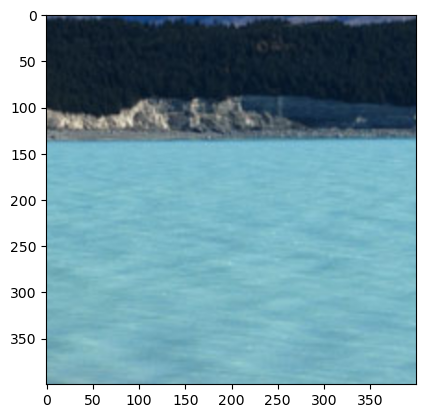

In [8]:
resize_cropped_region_2x = cv2.resize(cropped_region, None, fx=2, fy=2)
plt.imshow(resize_cropped_region_2x)

<span style="color: green; font-size: 20px;">Medthod 2: Specifying exact size of the output image</span>

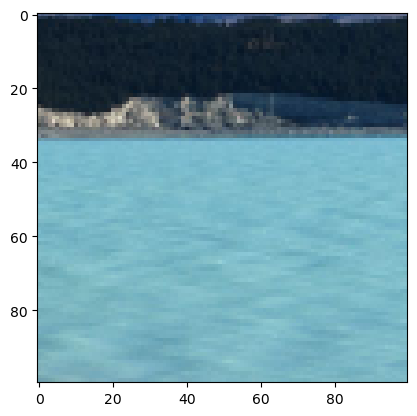

In [9]:
desired_width = 100
desired_height = 100
dim = (desired_width, desired_height)

# resize background image to same size as logo image
resized_cropped_region = cv2.resize(cropped_region, dsize=dim, interpolation=cv2.INTER_AREA)
plt.imshow(resized_cropped_region)

<span style="color: green; font-size: 20px;">Resize while maintaining aspect ratio</span>

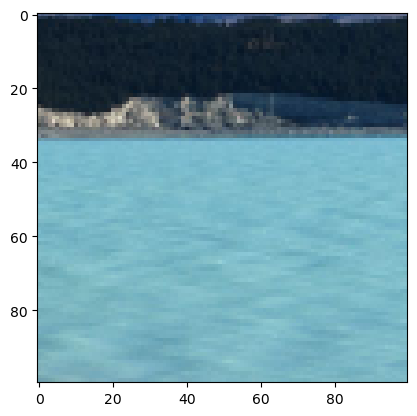

In [11]:
desired_width = 100
aspect_ratio = desired_width / cropped_region.shape[1]
desired_height = int(cropped_region.shape[0] * aspect_ratio)
dim = (desired_width, desired_height)

# Resize image
resized_cropped_region = cv2.resize(cropped_region, dsize=dim, interpolation=cv2.INTER_AREA)
plt.imshow(resized_cropped_region)

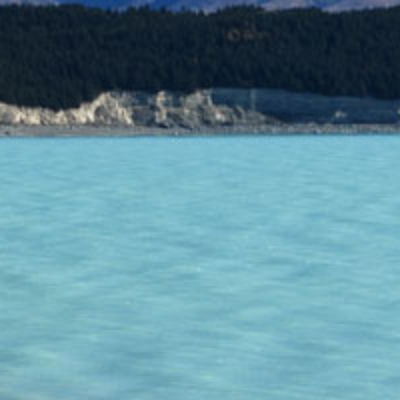

In [13]:
resize_cropped_region_2x = resize_cropped_region_2x[:,:,::-1]
cv2.imwrite("resize_cropped_image.png", resize_cropped_region_2x)
Image(filename="resize_cropped_image.png")

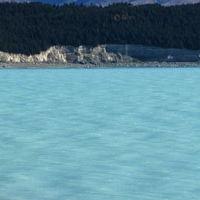

In [14]:
# Swap channel order
cropped_region = cropped_region[:, :, ::-1]

# Save cropped 'region'
cv2.imwrite("cropped_region.png", cropped_region)

# Display the cropped and resized image
Image(filename="cropped_region.png")

<span style="font-weight: bold; font-size: 30px;">Flipping Images</span>

<div>
    <p>
        The function <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">flip</span> flips the array in one of three different ways 
        (row and column indices are 0-based):
    </p>
</div>

<span style="color: green; font-size: 25px;">Function Syntax</span>

<div>
    <p>
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dst = cv.flip( src, flipCode )</span>
    </p>
    <p>
        <span style="font-weight: bold;">dst:</span> Output array of the same size and type as 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src</span>.
    </p>
</div>

<div>
    <p>The function has <span style="font-weight: bold;">2 required arguments</span>:</p>
    <ul>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src:</span> Input image.
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">flipCode:</span> A flag to specify how to flip the array:
            <ul>
                <li>
                    0 means flipping around the x-axis.
                </li>
                <li>
                    A positive value (for example, 1) means flipping around the y-axis.
                </li>
                <li>
                    A negative value (for example, -1) means flipping around both axes.
                </li>
            </ul>
        </li>
    </ul>
</div>

<span style="color: green; font-size: 24px;">OpenCV Documentation</span>
<ul>
    <li>
        <a href="https://docs.opencv.org/4.5.0/d2/de8/group__core__array.html#gaca7be533e3dac7feb70fc60635adf441" target="_blank" style="color: blue; text-decoration: underline;">flip: Documentation link</a>
    </li>
</ul>


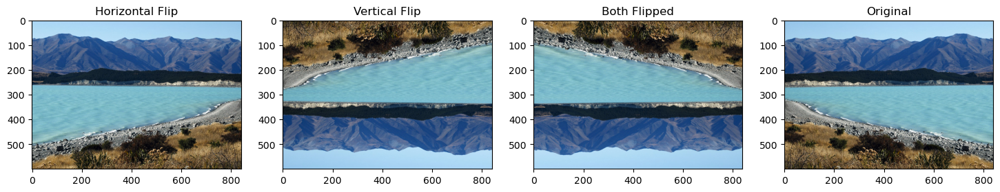

In [15]:
img_NZ_rgb_flipped_horz = cv2.flip(img_NZ_rgb, 1)  # x
img_NZ_rgb_flipped_vert = cv2.flip(img_NZ_rgb, 0)  # y
img_NZ_rgb_flipped_both = cv2.flip(img_NZ_rgb, -1) # both
plt.figure(figsize=(18, 5))
plt.subplot(141);plt.imshow(img_NZ_rgb_flipped_horz);plt.title("Horizontal Flip");
plt.subplot(142);plt.imshow(img_NZ_rgb_flipped_vert);plt.title("Vertical Flip");
plt.subplot(143);plt.imshow(img_NZ_rgb_flipped_both);plt.title("Both Flipped");
plt.subplot(144);plt.imshow(img_NZ_rgb);plt.title("Original");

<span style="font-weight: bold; font-size: 25px;">Annotating Images</span>

<div>
    <p>In this notebook we will cover how to annotate images using OpenCV. We will learn how to peform the following annotations to images.</p>
    <ul>
        <li>
            Draw lines
        </li>
        <li>
            Draw circles
        </li>
        <li>
            Draw rectangles
        </li>
        <li>
            Add text
        </li>
    </ul>
    <p>These are useful when you want to annotate your results for presentations or show a demo of your application. Annotations can also be useful during development and debugging.</p>
</div>

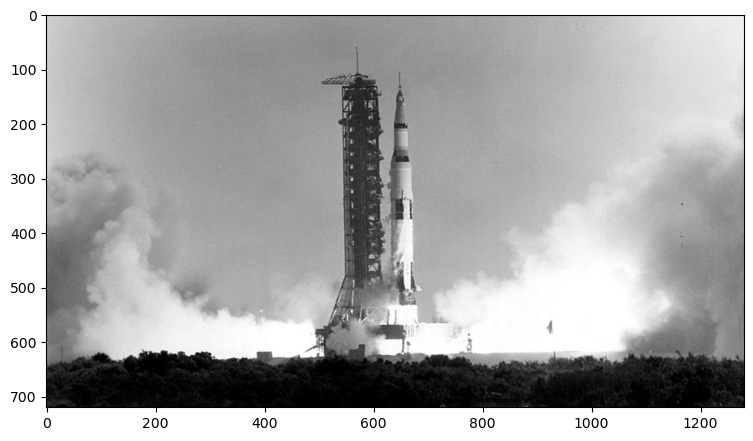

In [2]:
def download_and_unzip(url, save_path):
    print(f"Downloading and extracting assests....", end="")

    # Downloading zip file using urllib package.
    urlretrieve(url, save_path)

    try:
        # Extracting zip file using the zipfile package.
        with ZipFile(save_path) as z:
            # Extract ZIP file contents in the same directory.
            z.extractall(os.path.split(save_path)[0])

        print("Done")

    except Exception as e:
        print("\nInvalid file.", e)
URL = r"https://www.dropbox.com/s/48hboi1m4crv1tl/opencv_bootcamp_assets_NB3.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB3.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

# Read in an image
image = cv2.imread("Apollo_11_Launch.jpg", cv2.IMREAD_COLOR)

# Display the original image
plt.imshow(image[:, :, ::-1])

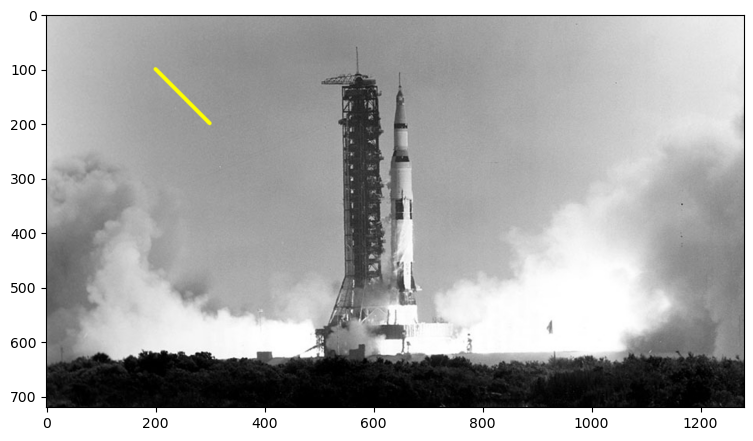

In [6]:
# Drawing in image
# 1. Draw line
imageLine = image.copy()
cv2.line(imageLine, (200,100), (300,200), (0,255,255), thickness=5, lineType=cv2.LINE_AA)
plt.imshow(imageLine[:,:,::-1])

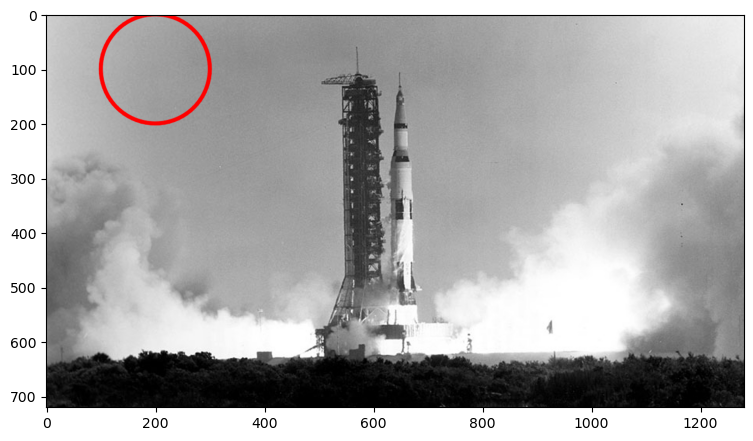

In [7]:
# 2. Draw circle
imageCircle = image.copy()
cv2.circle(imageCircle, (200,100), 100, (0,0,255), thickness=5, lineType=cv2.LINE_AA)
plt.imshow(imageCircle[:,:,::-1])

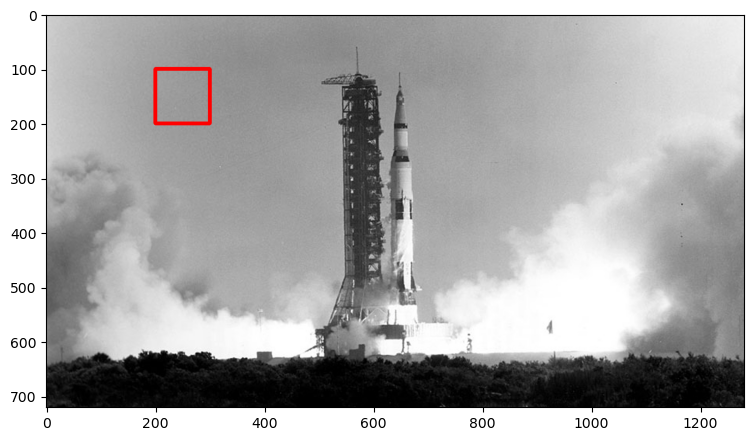

In [8]:
# 3. Draw Rectangle
imageRec = image.copy()
cv2.rectangle(imageRec, (200,100), (300,200), (0,0,255), thickness=5, lineType=cv2.LINE_8)
plt.imshow(imageRec[:,:,::-1])

<span style="font-weight: bold; font-size: 20px;">Adding text</span>

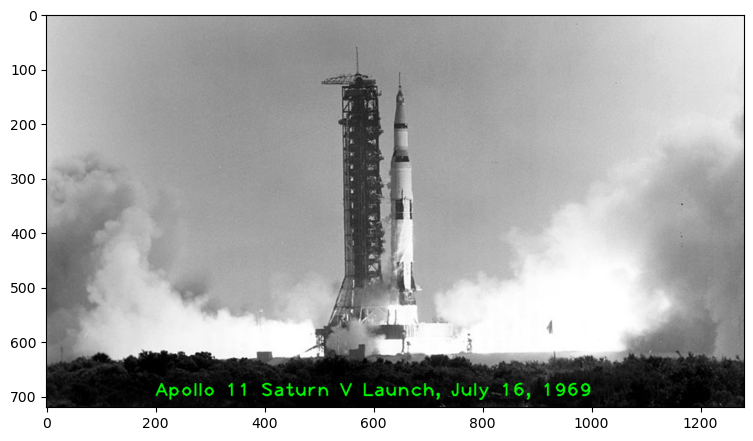

In [9]:
imageText = image.copy()
text = "Apollo 11 Saturn V Launch, July 16, 1969"
fontScale = 2.3
fontFace = cv2.FONT_HERSHEY_PLAIN
fontColor = (0, 255, 0)
fontThickness = 2

cv2.putText(imageText, text, (200, 700), fontFace, fontScale, fontColor, fontThickness, cv2.LINE_AA);

# Display the image
plt.imshow(imageText[:, :, ::-1])

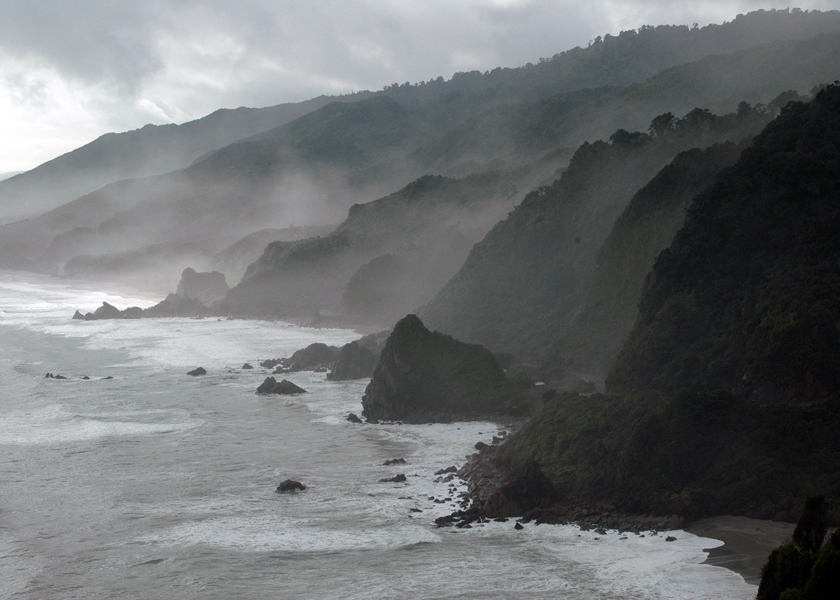

In [2]:
def download_and_unzip(url, save_path):
    print(f"Downloading and extracting assests....", end="")

    # Downloading zip file using urllib package.
    urlretrieve(url, save_path)
    
    try:
        # Extracting zip file using the zipfile package.
        with ZipFile(save_path) as z:
            # Extract ZIP file contents in the same directory.
            z.extractall(os.path.split(save_path)[0])

        print("Done")

    except Exception as e:
        print("\nInvalid file.", e)
URL = r"https://www.dropbox.com/s/0oe92zziik5mwhf/opencv_bootcamp_assets_NB4.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB4.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   
img_bgr = cv2.imread("New_Zealand_Coast.jpg", cv2.IMREAD_COLOR)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# Display 18x18 pixel image.
Image(filename="New_Zealand_Coast.jpg")

<span style="font-weight: bold; font-size: 30px;">Image Enhancement</span>

<span style="font-weight: bold; font-size: 25px;">Addition or Brightness</span>

<p>The first operation we discuss is simple addition of images. This results in increasing or decreasing the brightness of the image since we are eventually increasing or decreasing the intensity values of each pixel by the same amount. So, this will result in a global increase/decrease in brightness.</p>

Text(0.5, 1.0, 'Darker image')

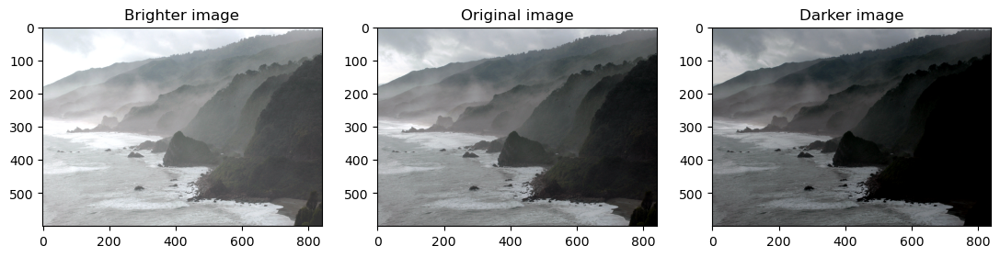

In [5]:
matrix = np.ones(img_rgb.shape, dtype="uint8") * 50
img_brighter = cv2.add(img_rgb, matrix)
img_darker = cv2.subtract(img_rgb, matrix)

plt.figure(figsize=[18,5])
plt.subplot(141); plt.imshow(img_brighter);plt.title("Brighter image")
plt.subplot(142); plt.imshow(img_rgb); plt.title("Original image")
plt.subplot(143);plt.imshow(img_darker);plt.title("Darker image")

<span style="font-weight: bold; font-size: 25px;">Multiplication or Contrast</span>

<p>Just like addition can result in brightness change, multiplication can be used to improve the contrast of the image.</p>
<p>Contrast is the difference in the intensity values of the pixels of an image. Multiplying the intensity values with a constant can make the difference larger or smaller ( if multiplying factor is < 1 ).</p>

Text(0.5, 1.0, 'Higher constrast')

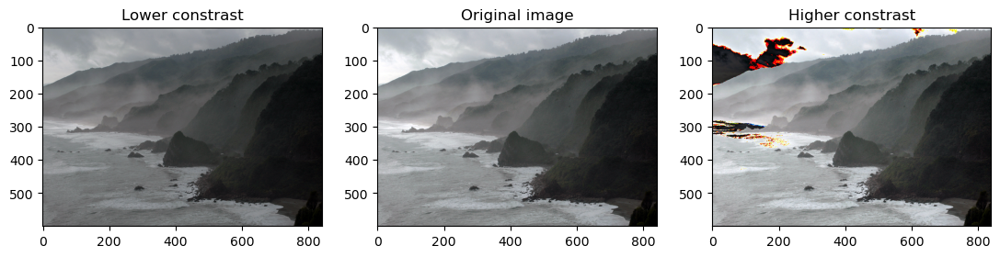

In [9]:
matrix1 = np.ones(img_rgb.shape) * 0.8 # nearer to 0 -> Less contrast, higher than 1 -> Higher contrast
matrix2 = np.ones(img_rgb.shape) * 1.2 # nearer to 0 -> Less contrast, higher than 1 -> Higher contrast
img_brighter_contrast = np.uint8(cv2.multiply(np.float64(img_rgb), matrix1))
img_darker_contrast = np.uint8(cv2.multiply(np.float64(img_rgb), matrix2))

plt.figure(figsize=[18,5])
plt.subplot(141); plt.imshow(img_brighter_contrast);plt.title("Lower constrast")
plt.subplot(142); plt.imshow(img_rgb); plt.title("Original image")
plt.subplot(143);plt.imshow(img_darker_contrast);plt.title("Higher constrast")

<span style="color: green; font-size: 20px;">What happened?</span>
<p>Can you see the weird colors in some areas of the image after multiplication?</p>
<p>The issue is that after multiplying, the values which are already high, are becoming greater than 255. Thus, the overflow issue. How do we overcome this?</p>
<p></p>
<span style="color: green; font-size: 25px;">Handling Overflow using np.clip</span>

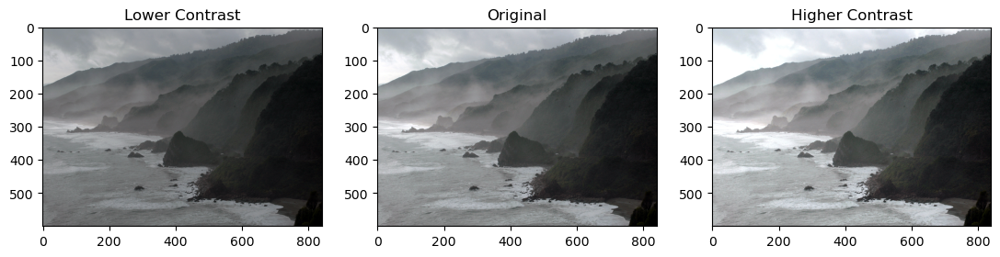

In [11]:
matrix1 = np.ones(img_rgb.shape) * 0.8
matrix2 = np.ones(img_rgb.shape) * 1.2

img_rgb_lower  = np.uint8(cv2.multiply(np.float64(img_rgb), matrix1))
img_rgb_higher = np.uint8(np.clip(cv2.multiply(np.float64(img_rgb), matrix2), 0, 255))

# Show the images
plt.figure(figsize=[18,5])
plt.subplot(141); plt.imshow(img_rgb_lower); plt.title("Lower Contrast");
plt.subplot(142); plt.imshow(img_rgb);       plt.title("Original");
plt.subplot(143); plt.imshow(img_rgb_higher);plt.title("Higher Contrast");

<span style="font-weight: bold; font-size: 25px;">Image Thresholding</span>

<div>
    <p>
        Binary Images have a lot of use cases in Image Processing. One of the most common use cases is that of creating masks. 
        Image Masks allow us to process specific parts of an image while keeping the other parts intact. 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">Image Thresholding</span> is used to create Binary Images from grayscale images. 
        You can use different thresholds to create different binary images from the same original image.
    </p>
</div>

<span style="color: green; font-size: 25px;">Function Syntax</span>

<div>
    <p>
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">retval, dst = cv2.threshold( src, thresh, maxval, type[, dst] )</span>
    </p>
    <p>
        <span style="font-weight: bold;">dst:</span> The output array of the same size and type and the same number of channels as 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src</span>.
    </p>
</div>

<div>
    <p>The function has <span style="font-weight: bold;">4 required arguments</span>:</p>
    <ul>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src:</span> Input array (multiple-channel, 8-bit or 32-bit floating point).
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">thresh:</span> Threshold value.
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">maxval:</span> Maximum value to use with the THRESH_BINARY and THRESH_BINARY_INV thresholding types.
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">type:</span> Thresholding type (see ThresholdTypes).
        </li>
    </ul>
</div>

<span style="color: green; font-size: 25px;">Adaptive Thresholding Syntax</span>

<div>
    <p>
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">dst = cv2.adaptiveThreshold( src, maxValue, adaptiveMethod, thresholdType, blockSize, C[, dst] )</span>
    </p>
    <p>
        <span style="font-weight: bold;">dst:</span> Destination image of the same size and the same type as 
        <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src</span>.
    </p>
</div>

<div>
    <p>The function has <span style="font-weight: bold;">6 required arguments</span>:</p>
    <ul>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">src:</span> Source 8-bit single-channel image.
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">maxValue:</span> Non-zero value assigned to the pixels for which the condition is satisfied.
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">adaptiveMethod:</span> Adaptive thresholding algorithm to use, see AdaptiveThresholdTypes. 
            The BORDER_REPLICATE | BORDER_ISOLATED is used to process boundaries.
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">thresholdType:</span> Thresholding type that must be either THRESH_BINARY or THRESH_BINARY_INV (see ThresholdTypes).
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">blockSize:</span> Size of a pixel neighborhood that is used to calculate a threshold value for the pixel: 3, 5, 7, and so on.
        </li>
        <li>
            <span style="background-color: #d3d3d3; padding: 2px; font-weight: bold;">C:</span> Constant subtracted from the mean or weighted mean (normally positive but may be zero or negative as well).
        </li>
    </ul>
</div>

<span style="color: green; font-size: 20px;">OpenCV Documentation</span>
<ul>
    <li>
        <a href="https://docs.opencv.org/4.5.1/d7/d1b/group__imgproc__misc.html#gae8a4a146d1ca78c626a53577199e9c57https://docs.opencv.org/4.5.1/d7/d4d/tutorial_py_thresholding.html" target="_blank" style="color: blue; text-decoration: underline;">Threshold: Documentation link</a>
    </li>
    <li>
        <a href="https://docs.opencv.org/4.x/d7/d4d/tutorial_py_thresholding.html" target="_blank" style="color: blue; text-decoration: underline;">Adaptive Threshold: Tutorial link</a>
    </li>
</ul>


100.0
(572, 800)


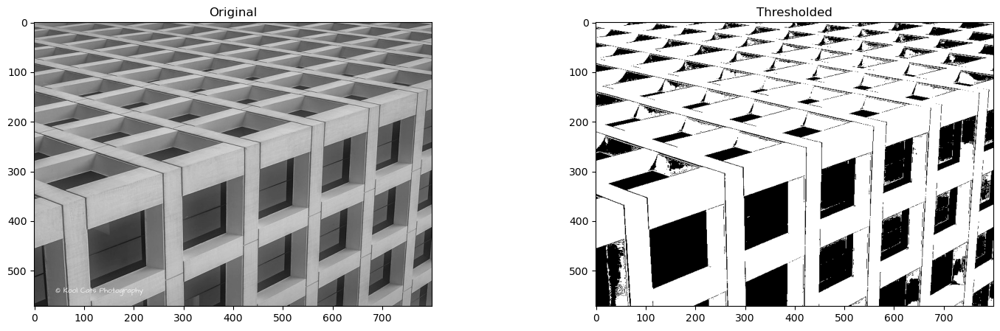

In [12]:
img_read = cv2.imread("building-windows.jpg", cv2.IMREAD_GRAYSCALE)
retval, img_thresh = cv2.threshold(img_read, 100, 255, cv2.THRESH_BINARY)
print(retval)
plt.figure(figsize=[18, 5])

plt.subplot(121);plt.imshow(img_read, cmap="gray");  plt.title("Original")
plt.subplot(122);plt.imshow(img_thresh, cmap="gray");plt.title("Thresholded")

print(img_thresh.shape)

<span style="font-weight: bold; font-size: 25px;">Application</span>
<p>
Suppose you wanted to build an application that could read (decode) sheet music. This is similar to Optical Character Recognigition (OCR) for text documents where the goal is to recognize text characters. In either application, one of the first steps in the processing pipeline is to isolate the important information in the image of a document (separating it from the background). This task can be accomplished with thresholding techniques. Let's take a look at an example.
</p>

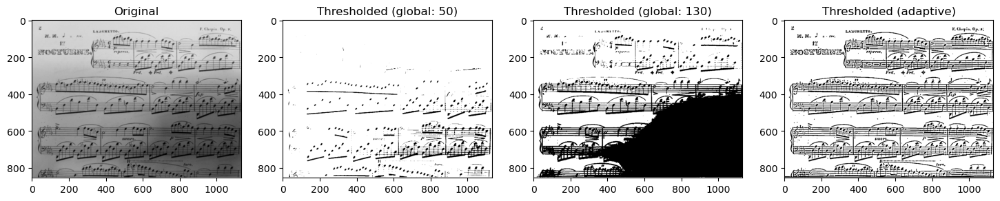

In [15]:
img_read = cv2.imread("Piano_Sheet_Music.png", cv2.IMREAD_GRAYSCALE)

retval, img_thresh_gb1 = cv2.threshold(img_read, 50, 255, cv2.THRESH_BINARY)
retval, img_thresh_gb2 = cv2.threshold(img_read, 130, 255, cv2.THRESH_BINARY)

# Adaptive Threshold
img_adaptive_thresh = cv2.adaptiveThreshold(img_read, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 7)

plt.figure(figsize=[18,15])
plt.subplot(141); plt.imshow(img_read, cmap="gray"); plt.title("Original")
plt.subplot(142); plt.imshow(img_thresh_gb1,cmap="gray");  plt.title("Thresholded (global: 50)");
plt.subplot(143); plt.imshow(img_thresh_gb2,cmap="gray");  plt.title("Thresholded (global: 130)");
plt.subplot(144); plt.imshow(img_adaptive_thresh,  cmap="gray");  plt.title("Thresholded (adaptive)");

## Key Guidelines for Choosing the Parameters

### Block Size (`11` in your case):
- Must be an **odd number** (3, 5, 7, 11, etc.).

#### General Rules:
- **Smaller block size** (3-7): Good for detecting fine details, but more sensitive to noise.
- **Larger block size** (11-21): Better for handling gradual lighting changes, but might miss fine details.
- **For sheet music:** Usually 11-15 works well because it's large enough to capture the context of musical notation.
- **Too large:** Can cause blurring of edges.
- **Too small:** Can create noisy results.

### C Value (`7` in your case):
- This is the **constant subtracted from the mean**.
- **Typical range:** 2-20.

#### Effects:
- **Lower values** (2-5): Create more white pixels, thinner lines.
- **Higher values** (8-15): Create more black pixels, thicker lines.
- **For sheet music:** Usually 5-8 works well to preserve note shapes.
- **Too high:** Makes the image too dark.
- **Too low:** Makes the image too light, might lose details.

### For Sheet Music Specifically:
- **Start with:** `block_size=11` and `C=7` (as in your example).
- If **notes appear broken:** Increase block size.
- If **staff lines are too thick:** Decrease C value.
- If **some notes are missing:** Try decreasing block size or increasing C value.
- If there's **background noise:** Try increasing block size or C value.

### The Optimal Parameters Often Depend On:
- Image resolution
- Lighting conditions
- Paper quality
- Printing quality
- Scan quality
- Amount of detail needed


# Bitwise Operations

## Function Syntax
Example API for `cv2.bitwise_and()`. Other similar functions include: 
- `cv2.bitwise_or()`
- `cv2.bitwise_xor()`
- `cv2.bitwise_not()`
```python
dst = cv2.bitwise_and(src1, src2[, dst[, mask]])
dst: Output array that has the same size and type as the input arrays.
```
The function has `2 required arguments`:
```python
src1: first input array or a scalar.
src2: second input array or a scalar.
```

An important optional argument is:
```
mask: optional operation mask, 8-bit single channel array, that specifies elements of the output array to be changed.
```

(200, 499)


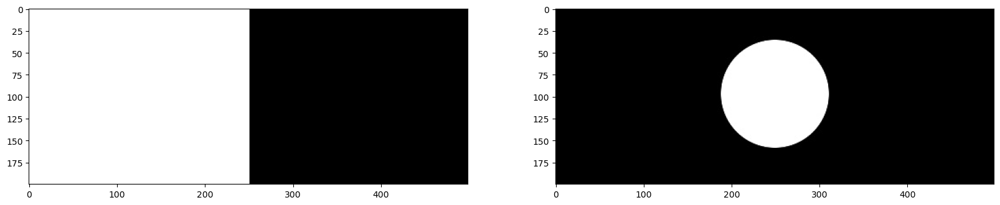

In [16]:
img_rec = cv2.imread("rectangle.jpg", cv2.IMREAD_GRAYSCALE)

img_cir = cv2.imread("circle.jpg", cv2.IMREAD_GRAYSCALE)

plt.figure(figsize=[20, 5])
plt.subplot(121);plt.imshow(img_rec, cmap="gray")
plt.subplot(122);plt.imshow(img_cir, cmap="gray")
print(img_rec.shape)

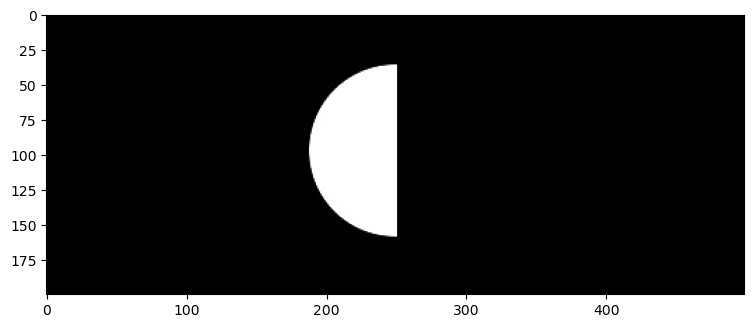

In [17]:
# AND op
result = cv2.bitwise_and(img_rec, img_cir, mask=None)
plt.imshow(result, cmap="gray")

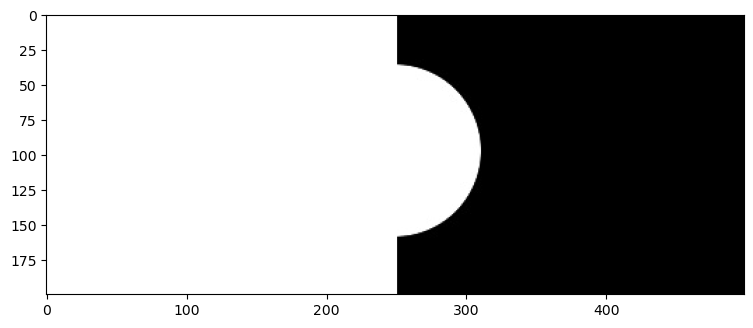

In [18]:
# OR op
result = cv2.bitwise_or(img_rec, img_cir, mask=None)
plt.imshow(result, cmap="gray")

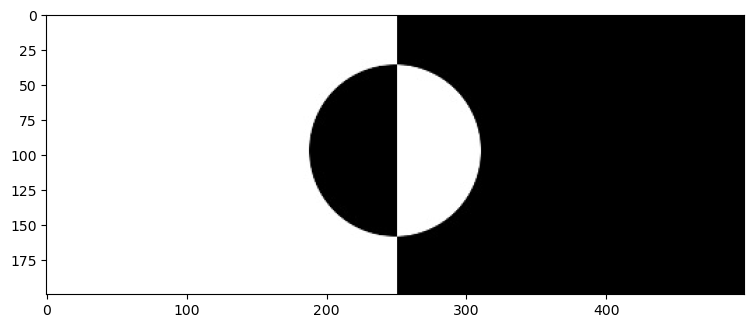

In [19]:
# XOR op
result = cv2.bitwise_xor(img_rec, img_cir, mask=None)
plt.imshow(result, cmap="gray")

## Application: Logo Manipulation
In this section we will show you how to fill in the white lettering of the Coca-Cola logo below with a background image.

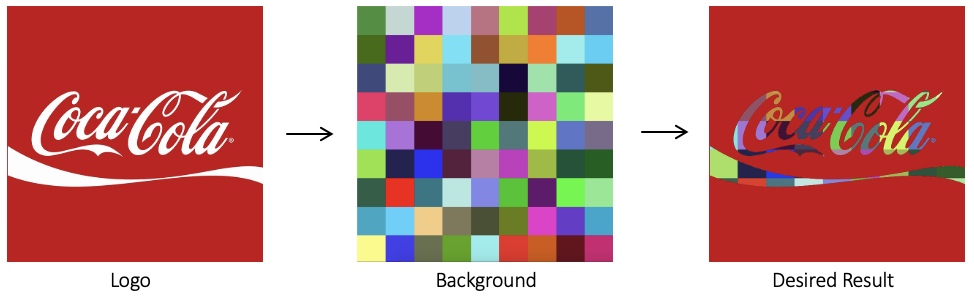

In [21]:
Image(filename='Logo_Manipulation.png')

(700, 700, 3)


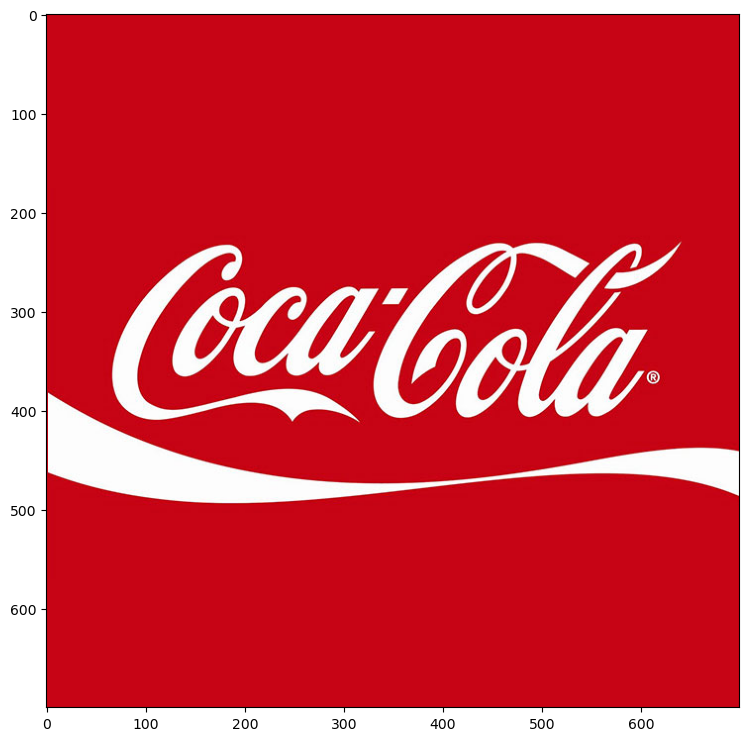

In [22]:
# Read Foreground image
img_bgr = cv2.imread("coca-cola-logo.png")
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb)

print(img_rgb.shape)

logo_w = img_rgb.shape[0]
logo_h = img_rgb.shape[1]

(700, 700, 3)


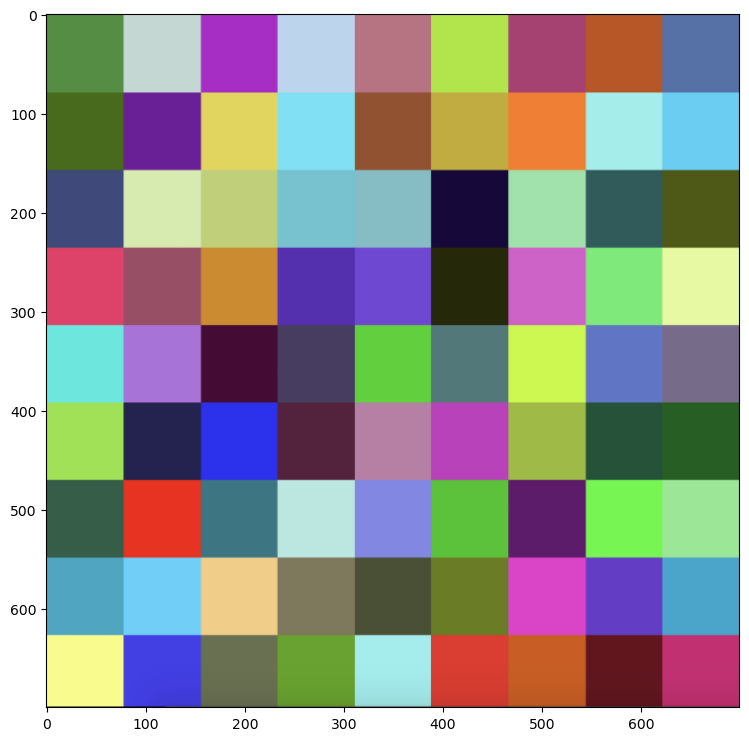

In [24]:
# Read background image
# Read in image of color cheackerboad background
img_background_bgr = cv2.imread("checkerboard_color.png")
img_background_rgb = cv2.cvtColor(img_background_bgr, cv2.COLOR_BGR2RGB)

# Set desired width (logo_w) and maintain image aspect ratio
aspect_ratio = logo_w / img_background_rgb.shape[1]
dim = (logo_w, int(img_background_rgb.shape[0] * aspect_ratio))

# Resize background image to same size as logo image
img_background_rgb = cv2.resize(img_background_rgb, dim, interpolation=cv2.INTER_AREA)

plt.imshow(img_background_rgb)
print(img_background_rgb.shape)

(700, 700)


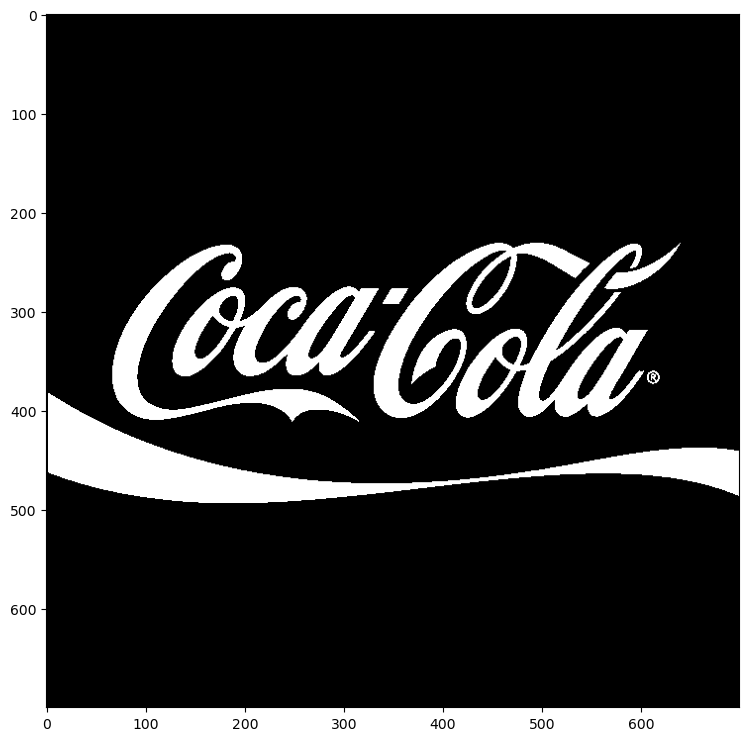

In [25]:
# Create mask for original image
img_gray = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2GRAY)

# Apply global thresholding to creat a binary mask of the logo
retval, img_mask = cv2.threshold(img_gray, 127, 255, cv2.THRESH_BINARY)

plt.imshow(img_mask, cmap="gray")
print(img_mask.shape)

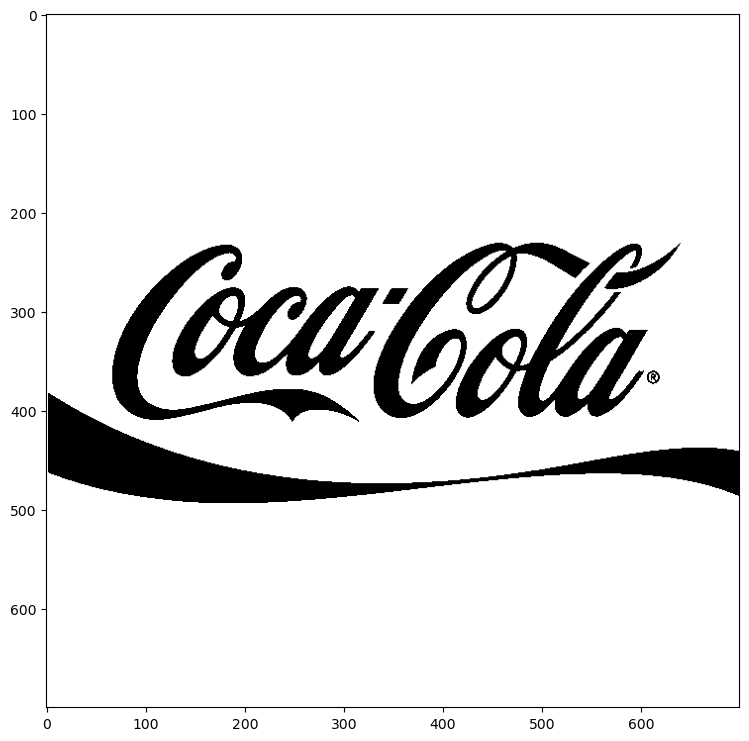

In [27]:
# Create an inverse mask
img_mask_inv = cv2.bitwise_not(img_mask)
plt.imshow(img_mask_inv, cmap="gray")

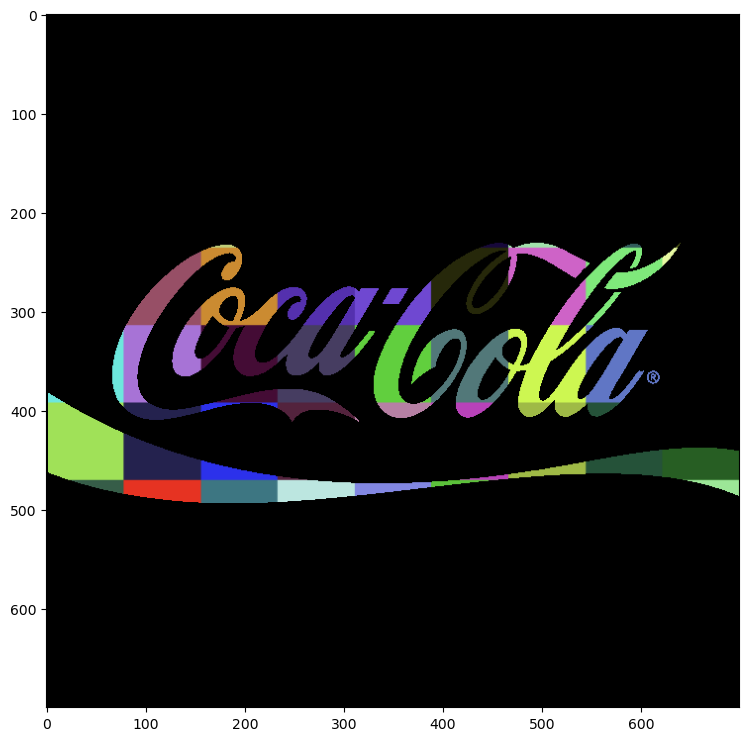

In [28]:
# Create colorful background "behind" the logo lettering
img_background = cv2.bitwise_and(img_background_rgb, img_background_rgb, mask=img_mask)
plt.imshow(img_background)

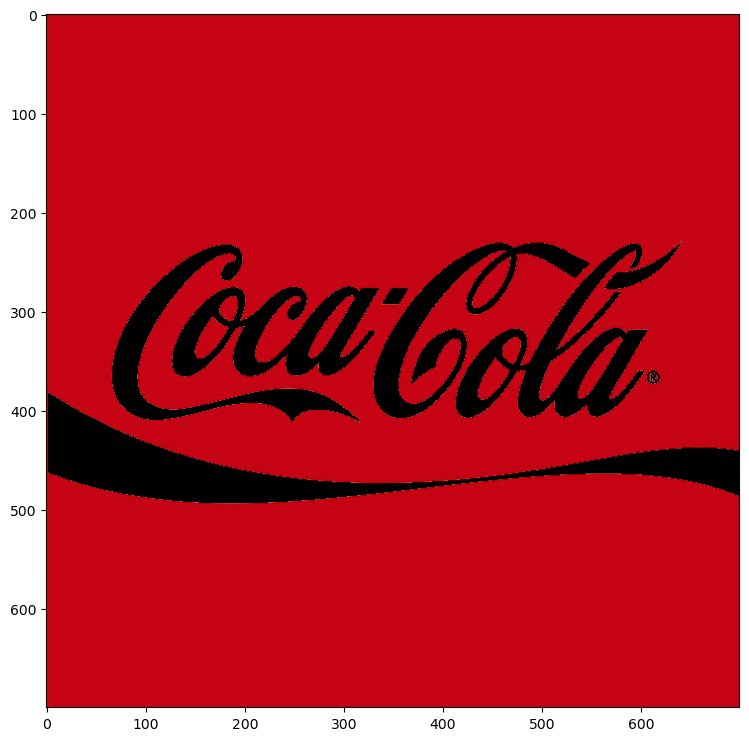

In [29]:
# Isolate foreground (red from original image) using the inverse mask
img_foreground = cv2.bitwise_and(img_rgb, img_rgb, mask=img_mask_inv)
plt.imshow(img_foreground)

True

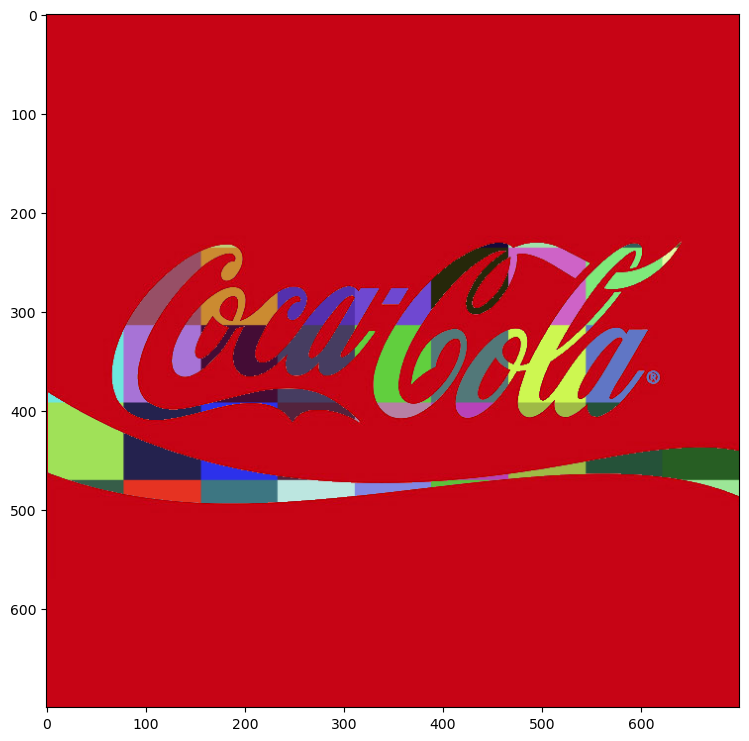

In [32]:
# Add the two previous results obtain the final result
result = cv2.add(img_background, img_foreground)
plt.imshow(result)
cv2.imwrite("logo_final.png", result[:, :, ::-1])

# Access the camera

In [33]:
s = 0
if len(sys.argv) > 1:
    s = sys.argv[1]

source = cv2.VideoCapture(s)

win_name = 'Camera Preview'
cv2.namedWindow(win_name, cv2.WINDOW_NORMAL)

while cv2.waitKey(1) != 27: # Escape
    has_frame, frame = source.read()
    if not has_frame:
        break
    cv2.imshow(win_name, frame)

source.release()
cv2.destroyWindow(win_name)

# Writing a video using OpenCV
While building applications, it becomes important to save demo videos of your work as well as many applications themselves might require saving a video clip. For example, in a surveiallance application, you might have to save a video clip as soon as you see something unusual happening.

In this notebook, we will describe how to save a video in avi and mp4 formats using openCV.

In [35]:
URL = r"https://www.dropbox.com/s/p8h7ckeo2dn1jtz/opencv_bootcamp_assets_NB6.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB6.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

## Read video from source

In [37]:
source = "race_car.mp4"
cap = cv2.VideoCapture(source)

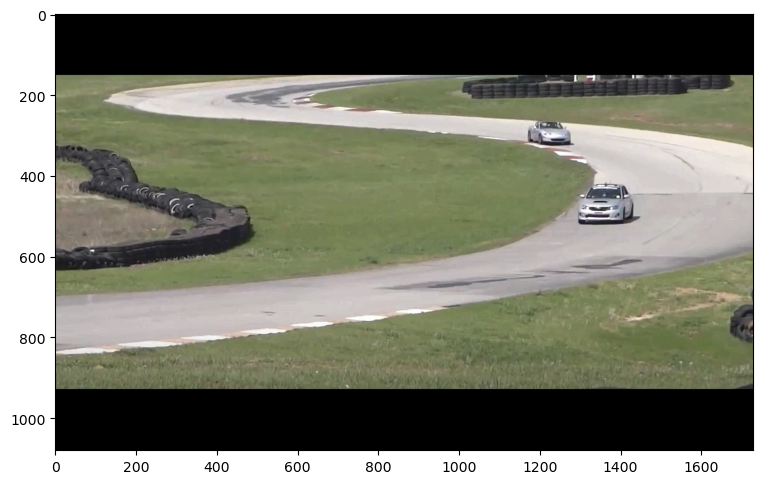

In [41]:
if not cap.isOpened():
    print("Error")
ret, frame = cap.read()
# display one frame
plt.imshow(frame[...,::-1])

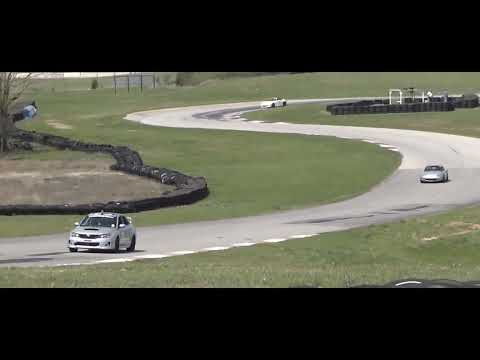

In [43]:
# display the video file
video = YouTubeVideo("RwxVEjv78LQ", width=600, height=400)
display(video)

## Write Video using OpenCV
For writing the video, you need to create a videowriter object with the right parameters.

### Function Syntax
VideoWriter object = cv.VideoWriter(filename, fourcc, fps, frameSize )

where, `Parameters`
```python
filename: Name of the output video file.

fourcc: 4-character code of codec used to compress the frames. For example, VideoWriter::fourcc('P','I','M','1') is a MPEG-1 codec, VideoWriter::fourcc('M','J','P','G') is a motion-jpeg codec etc. List of codes can be obtained at Video Codecs by FOURCC page. FFMPEG backend with MP4 container natively uses other values as fourcc code: see ObjectType, so you may receive a warning message from OpenCV about fourcc code conversion.

fps: Framerate of the created video stream.

frameSize: Size of the video frames.
```

In [44]:
# Default resolutions of the frame are obtained.
# Convert the resolutions from float to integer.
frame_width = int(cap.get(3))
frame_height = int(cap.get(4))

# Define codec and create VideoWriter Object
out_avi = cv2.VideoWriter("race_car_out.avi", cv2.VideoWriter_fourcc("M", "J", "P", "G"), 10, (frame_width, frame_height))
out_mp4 = cv2.VideoWriter("race_car_out.mp4", cv2.VideoWriter_fourcc(*"XVID"), 10, (frame_width, frame_height))

## Read frames and write to file
We will read the frames from the race-car video and write the same to the two objects we created in the previous step. We should release the objects after the task is complete.

In [45]:
# Read until video is completed
while cap.isOpened():
    # Capture frame-by-frame
    ret, frame = cap.read()

    if ret:
        # Write the frame to the output files
        out_avi.write(frame)
        out_mp4.write(frame)

    # Break the loop
    else:
        break

In [46]:
# When everything done, release the VideoCapture and VideoWriter objects
cap.release()
out_avi.release()
out_mp4.release()

## Image Alignment

In [4]:
URL = r"https://www.dropbox.com/s/zuwnn6rqe0f4zgh/opencv_bootcamp_assets_NB8.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB8.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

### Step 1: Read Tempalate and Scanned Image

Reading reference image: form.jpg
Reading image to align: scanned-form.jpg


Text(0.5, 1.0, 'Scanned Form')

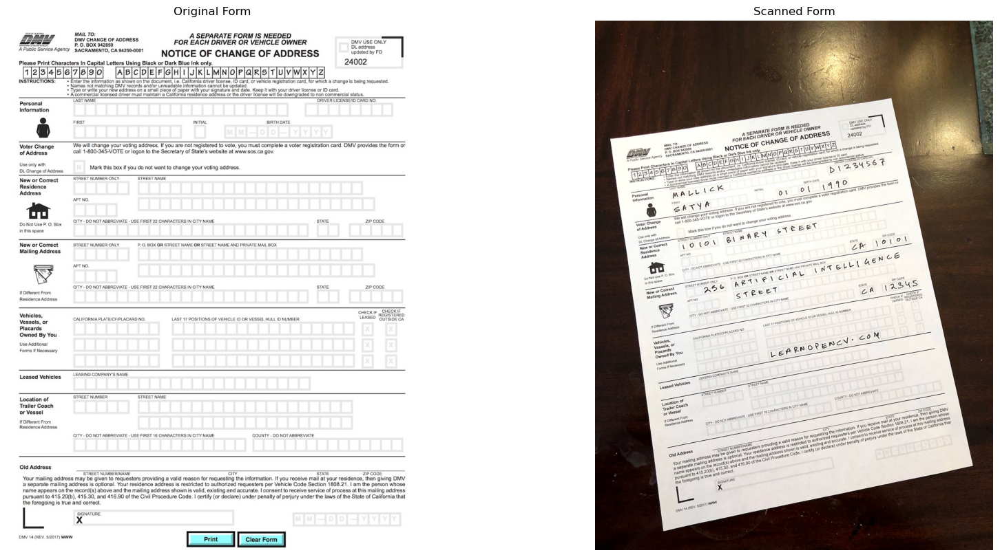

In [24]:
refFileName = "form.jpg"
print("Reading reference image:", refFileName)
im1 = cv2.imread(refFileName, cv2.IMREAD_COLOR)
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2RGB)

# Read image to be aligned
imFileName = "scanned-form.jpg"
print("Reading image to align:", imFileName)
im2 = cv2.imread(imFileName, 1)
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)

# Display images
plt.figure(figsize=[20, 10]); 
plt.subplot(121); plt.axis('off'); plt.imshow(im1); plt.title("Original Form")
plt.subplot(122); plt.axis('off'); plt.imshow(im2); plt.title("Scanned Form")

### Step 2: Find keypoints in both Images
Think of keypoints as corner points that are stable under image transformations

In [25]:
# convert iamges to grayscale
im1_gray = cv2.cvtColor(im1, cv2.COLOR_RGB2GRAY)
im2_gray = cv2.cvtColor(im2, cv2.COLOR_RGB2GRAY)

# Detect ORB features and compute descriptors
MAX_NUM_FEATURES = 500
orb = cv2.ORB_create(MAX_NUM_FEATURES)
keypoints1, descriptors1 = orb.detectAndCompute(im1_gray, None)
keypoints2, descriptors2 = orb.detectAndCompute(im2_gray, None)

# display
im1_display = cv2.drawKeypoints(im1, keypoints1, outImage=np.array([]), color=(255,0,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im2_display = cv2.drawKeypoints(im2, keypoints2, outImage=np.array([]), color=(255,0,0), flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

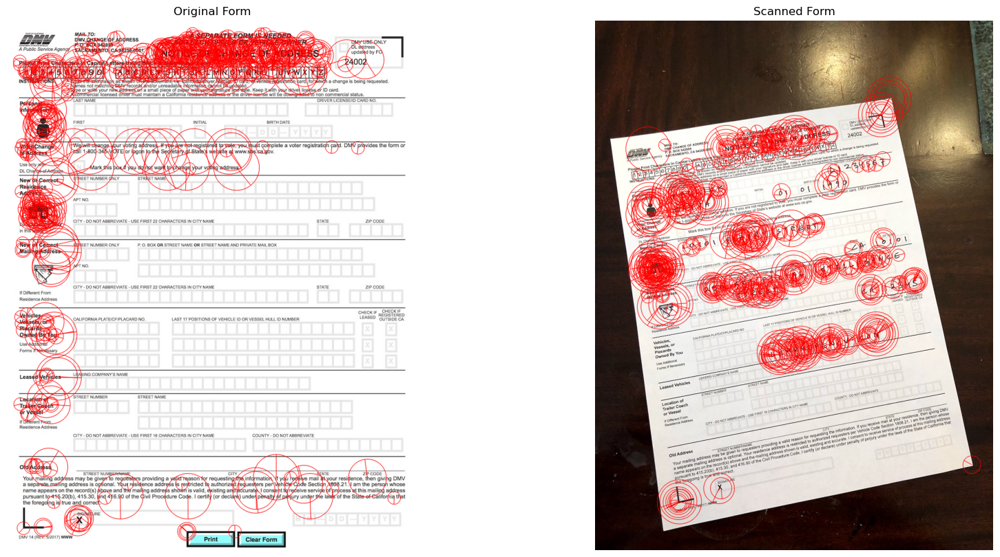

In [26]:
plt.figure(figsize=[20,10])
plt.subplot(121); plt.axis('off'); plt.imshow(im1_display); plt.title("Original Form");
plt.subplot(122); plt.axis('off'); plt.imshow(im2_display); plt.title("Scanned Form");

### Step 3 : Match keypoints in the two image

In [27]:
# Match features
matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)

# Converting to list for sorting as tuples of immutable objects
matches = list(matcher.match(descriptors1, descriptors2, None))

# Sort matches by score
matches.sort(key=lambda x: x.distance, reverse=False)

# Remove not so good matches
numGoodMatches = int(len(matches) * 0.1)
matches = matches[:numGoodMatches]

Text(0.5, 1.0, 'Original Form')

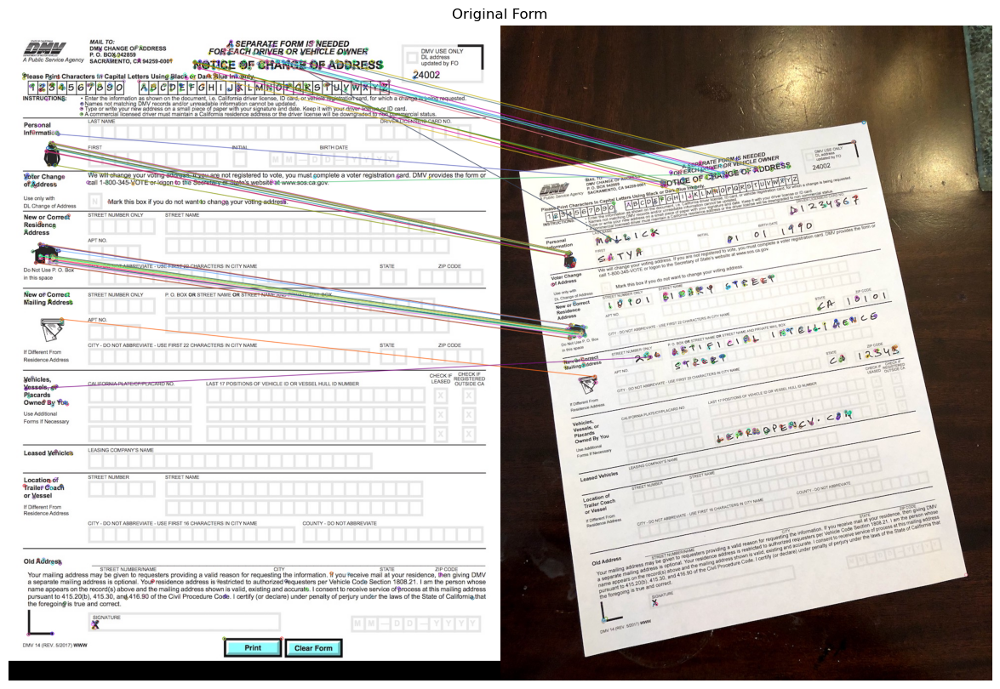

In [28]:
# Draw top matches
im_matches = cv2.drawMatches(im1, keypoints1, im2, keypoints2, matches, None)

plt.figure(figsize=[40,10])
plt.imshow(im_matches);plt.axis("off");plt.title("Original Form")

### Step 4: Find Homography

In [29]:
# Exact location of good matches
points1 = np.zeros((len(matches), 2), dtype=np.float32)
points2 = np.zeros((len(matches), 2), dtype=np.float32)

for i, match in enumerate(matches):
    points1[i, :] = keypoints1[match.queryIdx].pt
    points2[i, :] = keypoints2[match.trainIdx].pt

# Find homography
h, mask = cv2.findHomography(points2, points1, cv2.RANSAC)

### Step 5: Warp image

Text(0.5, 1.0, 'Scanned Form')

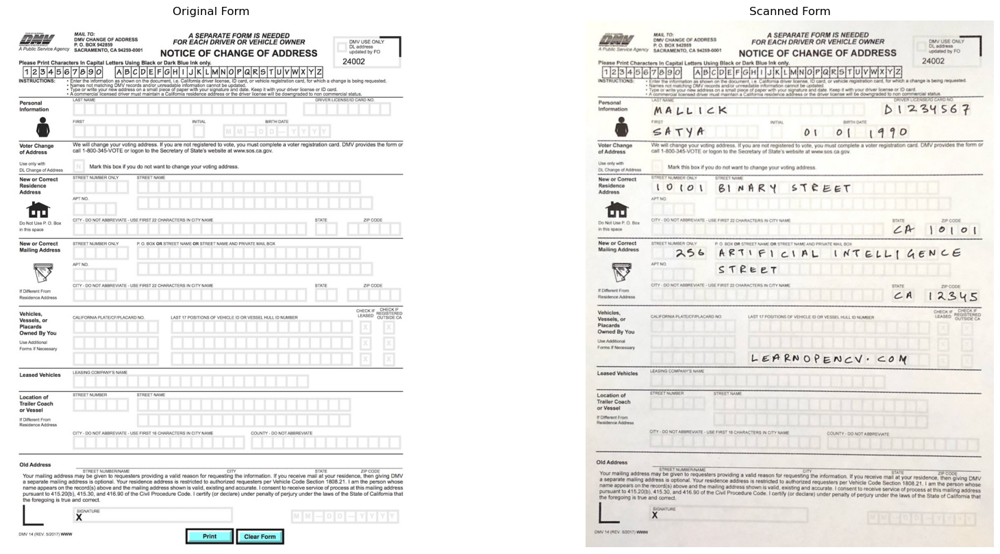

In [30]:
# Use homography to warp image
height, width, channels = im1.shape
im2_reg = cv2.warpPerspective(im2, h, (width, height))

# Display results
plt.figure(figsize=[20, 10])
plt.subplot(121);plt.imshow(im1);    plt.axis("off");plt.title("Original Form")
plt.subplot(122);plt.imshow(im2_reg);plt.axis("off");plt.title("Scanned Form")

## Creating Panoramas using OpenCV

In [32]:
URL = r"https://www.dropbox.com/s/0o5yqql1ynx31bi/opencv_bootcamp_assets_NB9.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB9.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

### Steps for Creating Panoramas
1. Find keypoints in all images
2. Find pairwise correspondences
3. Estimate pairwise Homographies
4. Refine Homographies
5. Stitch with Blending

### Steps for Creating Panoramas using OpenCV

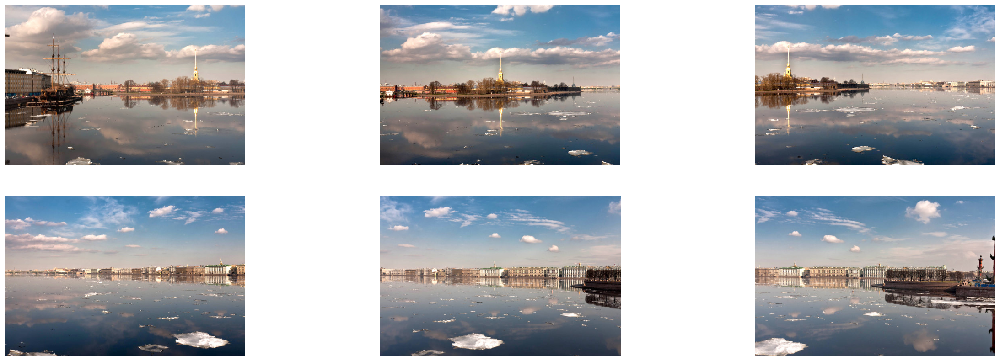

In [33]:
# Read Images

imagefiles = glob.glob(f"boat{os.sep}*")
imagefiles.sort()


images = []
for filename in imagefiles:
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    images.append(img)

num_images = len(images)

# Display Images
plt.figure(figsize=[30, 10])
num_cols = 3
num_rows = math.ceil(num_images / num_cols)
for i in range(0, num_images):
    plt.subplot(num_rows, num_cols, i + 1)
    plt.axis("off")
    plt.imshow(images[i])

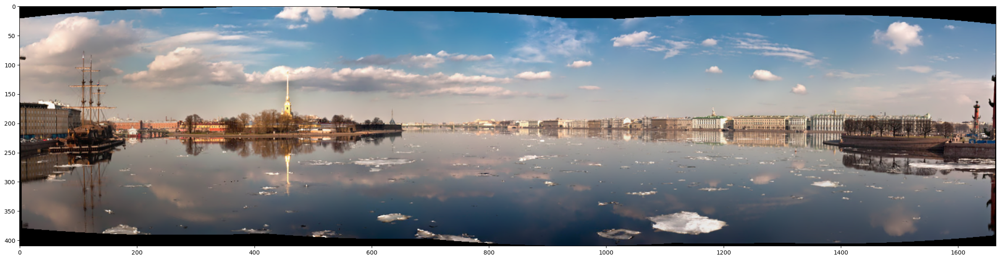

In [34]:
# Stitch Images
stitcher = cv2.Stitcher_create()
status, result = stitcher.stitch(images)

if status == 0:
    plt.figure(figsize=[30, 10])
    plt.imshow(result)

## High Dynamic Range (HDR) Imaging

In [35]:
URL = r"https://www.dropbox.com/s/qa1hsyxt66pvj02/opencv_bootcamp_assets_NB10.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), "opencv_bootcamp_assets_NB10.zip")

# Download if assest ZIP does not exists.
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)

### Basic Idea
1. The `dynamic range` of images is limited to 8-bits (0 - 255) per channel
2. Very bright pixels saturate to 255
3. Very dark pixels clip to 0

In [36]:
def readImagesAndTimes():
    # List of file names
    filenames = ["img_0.033.jpg", "img_0.25.jpg", "img_2.5.jpg", "img_15.jpg"]

    # List of exposure times
    times = np.array([1 / 30.0, 0.25, 2.5, 15.0], dtype=np.float32)

    # Read images
    images = []
    for filename in filenames:
        im = cv2.imread(filename)
        images.append(im)

    return images, times

### Step 2: Align Images

In [37]:
# Read images and exposure times
images, times = readImagesAndTimes()

# Align Images
alignMTB = cv2.createAlignMTB()
alignMTB.process(images, images)

### Step 3: Estimate Camera Response Function

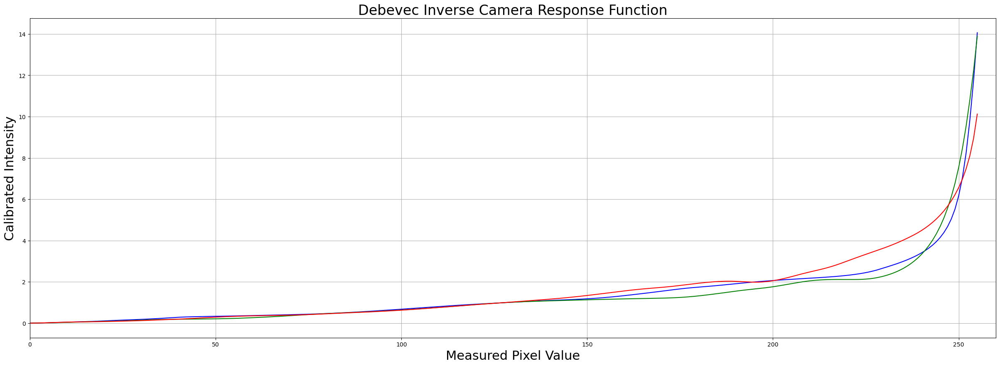

In [40]:
# Find Camera Response Function (CRF)
caliberateDebevec = cv2.createCalibrateDebevec()
responseDebevec = caliberateDebevec.process(images, times)

# Plot CRF
x = np.arange(256, dtype=np.uint8)
y = np.squeeze(responseDebevec)

ax = plt.figure(figsize=(30,10))

plt.title("Debevec Inverse Camera Response Function", fontsize=24)
plt.xlabel("Measured Pixel Value", fontsize=22)
plt.ylabel("Calibrated Intensity", fontsize=22)
plt.xlim([0, 260])
plt.grid()
plt.plot(x, y[:, 0], "b", x, y[:, 1], "g", x, y[:, 2], "r")

### Step 4: Merge Exposure into an HDR Image

In [41]:
# Merge images into an HDR linear image
mergeDebevec = cv2.createMergeDebevec()
hdrDebevec = mergeDebevec.process(images, times, responseDebevec)

### Step 5: Tonemapping
Many Tonemapping algorithms are available in OpenCV. We chose Drago as it has more controls.

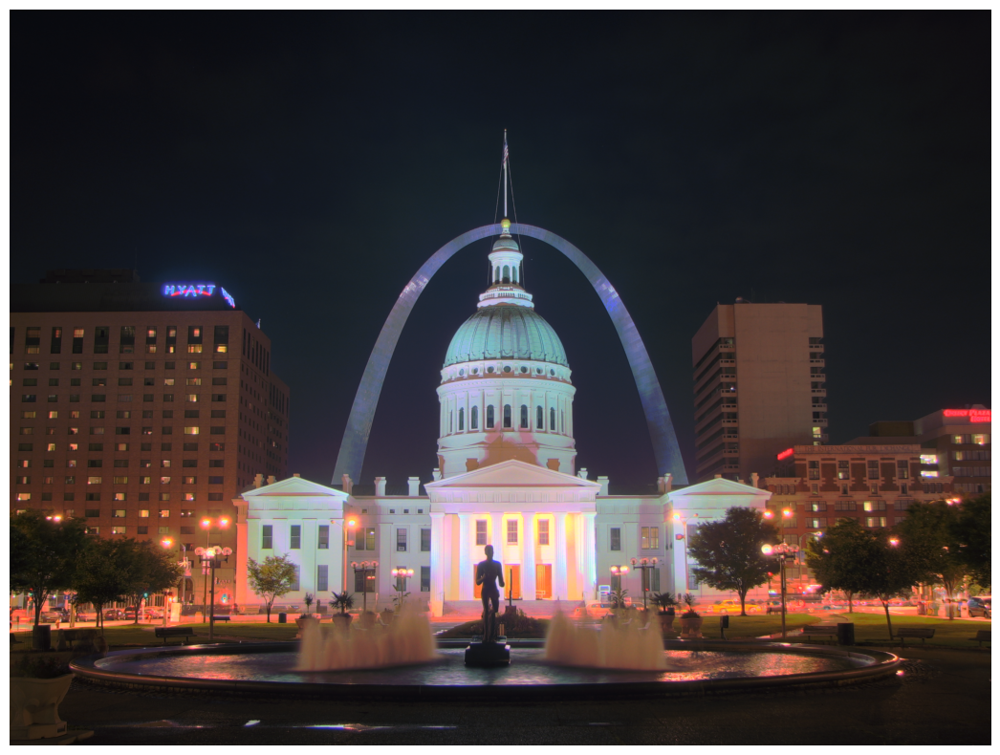

In [42]:
# Tonemap using Drago's method to obtain 24-bit color image
tonemapDrago = cv2.createTonemapDrago(1.0, 0.7)
ldrDrago = tonemapDrago.process(hdrDebevec)
ldrDrago = 3 * ldrDrago

# Saving image
cv2.imwrite("ldr-Drago.jpg", 255*ldrDrago)

# Plotting image
plt.figure(figsize=(20, 10));plt.imshow(np.clip(ldrDrago, 0, 1)[:,:,::-1]);plt.axis("off");

Tonemaping using Reinhard's method ... 


(-0.5, 2815.5, 2111.5, -0.5)

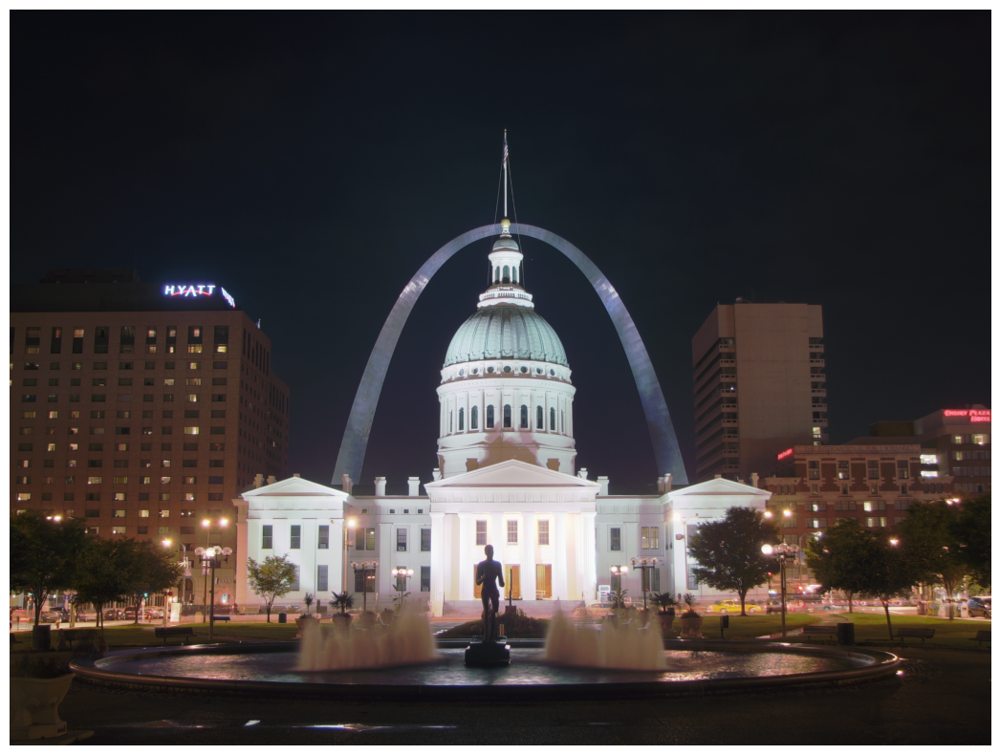

In [43]:
# Tonemap using Reinhard's method to obtain 24-bit color image
print("Tonemaping using Reinhard's method ... ")
tonemapReinhard = cv2.createTonemapReinhard(1.5, 0, 0, 0)
ldrReinhard = tonemapReinhard.process(hdrDebevec)

# Saving image
cv2.imwrite("ldr-Reinhard.jpg", ldrReinhard * 255)

# Plotting image
plt.figure(figsize=(20, 10));plt.imshow(np.clip(ldrReinhard, 0, 1)[:,:,::-1]);plt.axis("off")

Tonemaping using Mantiuk's method ... 


(-0.5, 2815.5, 2111.5, -0.5)

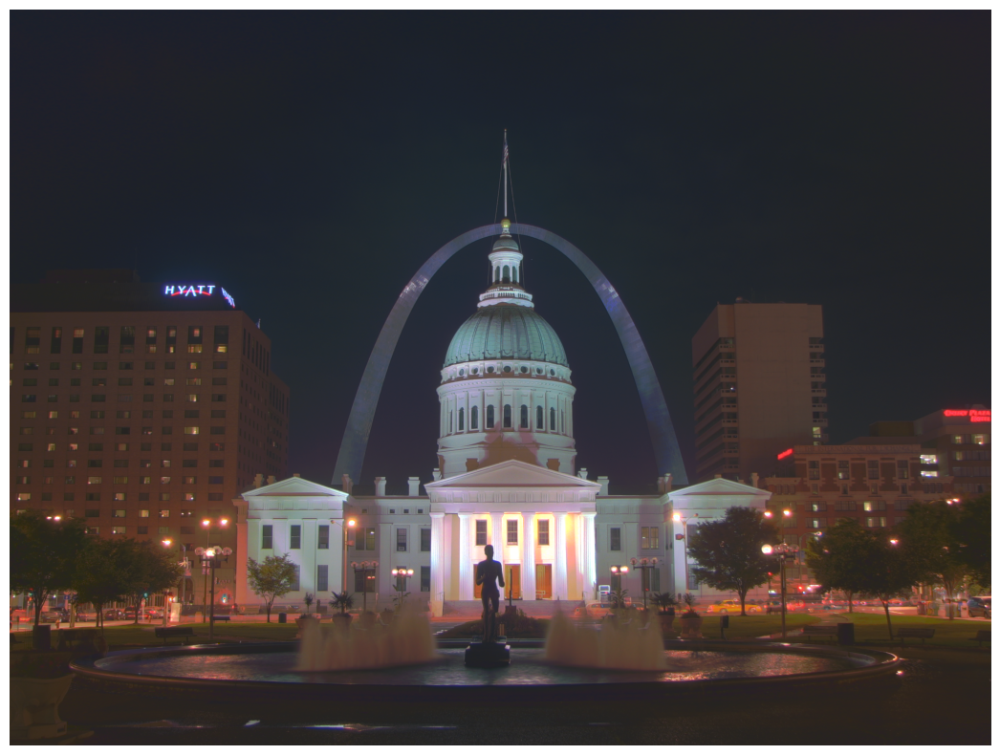

In [44]:
# Tonemap using Mantiuk's method to obtain 24-bit color image
print("Tonemaping using Mantiuk's method ... ")
tonemapMantiuk = cv2.createTonemapMantiuk(2.2, 0.85, 1.2)
ldrMantiuk = tonemapMantiuk.process(hdrDebevec)
ldrMantiuk = 3 * ldrMantiuk

# save the image using cv2.imwrite
cv2.imwrite("ldr-Mantiuk.jpg", ldrMantiuk * 255)

# plot the image using plt.imshow
plt.figure(figsize=(20, 10));plt.imshow(np.clip(ldrMantiuk, 0, 1)[:,:,::-1]);plt.axis("off")

In [3]:
URL = r"https://www.dropbox.com/s/ld535c8e0vueq6x/opencv_bootcamp_assets_NB11.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB11.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

### Tracker Class in OpenCV
1. BOOSTING
2. MIL
3. KCF
4. CRST
5. TLD
    - Tends to recover from occulusions
6. MEDIANFLOW
    - Good for predictable slow motion
7. GOTURN
    - Deep Learning based
    - Most Accurate
8. MOSSE
    Fastest

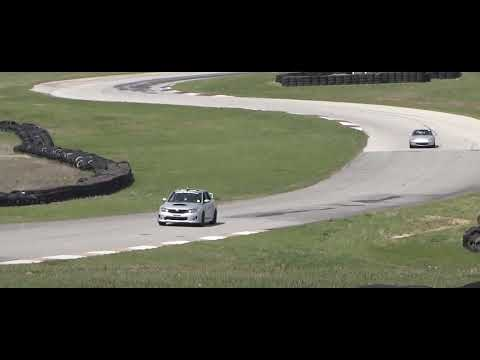

In [4]:
video = YouTubeVideo("XkJCvtCRdVM", width=1024, height=640)
display(video)

In [28]:
video_input_filename = "race_car.mp4"

def drawRectangle(frame, bbox):
    p1 = (int(bbox[0]), int(bbox[1]))
    p2 = (int(bbox[0] + bbox[2]), int(bbox[1] + bbox[3]))
    cv2.rectangle(frame, p1, p2, (255,0,0), 2, 1)

def displayRectangle(frame, bbox):
    plt.figure(figsize=(20,10))
    frameCopy = frame.copy()
    drawRectangle(frameCopy, bbox)
    frameCopy = cv2.cvtColor(frameCopy, cv2.COLOR_RGB2BGR)
    plt.imshow(frameCopy)
    plt.axis("off")
    
def drawText(frame, txt, location, color=(50, 170, 50)):
    cv2.putText(frame, txt, location, cv2.FONT_HERSHEY_SIMPLEX, 1, color, 3)

### Create the Tracker instance

In [29]:
tracker_types = [
    "BOOSTING",
    "MIL",
    "KCF",
    "CSRT",
    "TLD",
    "MEDIANFLOW",
    "GOTURN",
    "MOSSE",
]

tracker_type = tracker_types[2]

if tracker_type == "BOOSTING":
    tracker = cv2.legacy.TrackerBoosting.create()
elif tracker_type == "MIL":
    tracker = cv2.legacy.TrackerMIL.create()
elif tracker_type == "KCF":
    tracker = cv2.TrackerKCF.create()
elif tracker_type == "CSRT":
    tracker = cv2.TrackerCSRT.create()
elif tracker_type == "TLD":
    tracker = cv2.legacy.TrackerTLD.create()
elif tracker_type == "MEDIANFLOW":
    tracker = cv2.legacy.TrackerMedianFlow.create()
elif tracker_type == "GOTURN":
    tracker = cv2.TrackerGOTURN.create()
else:
    tracker = cv2.legacy.TrackerMOSSE.create()

### Read input video & Setup output Video

In [30]:
# Read video
video = cv2.VideoCapture(video_input_filename)
has_frame, frame = video.read()

if not video.isOpened():
    print("Could not open the video")
    sys.exit()
else:
    width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))

video_output_filename = "race_car" + tracker_type + ".mp4"
video_out = cv2.VideoWriter(video_output_filename, cv2.VideoWriter_fourcc(*"XVID"), 10, (width, height))

video_output_filename

'race_carKCF.mp4'

### Define Bounding Box

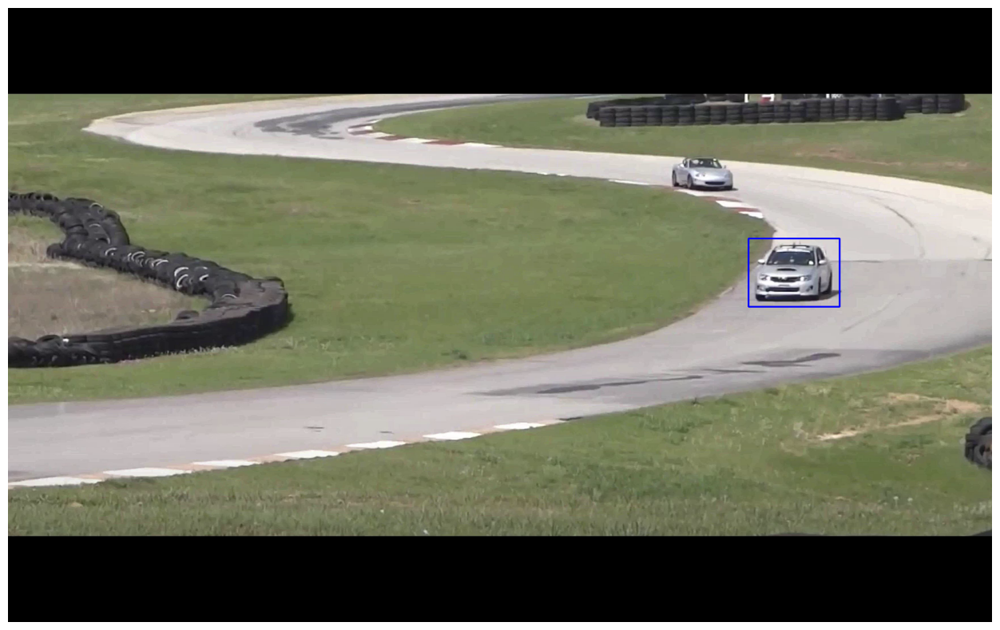

In [31]:
# Define a bounding box
bbox = (1300, 405, 160, 120)
# bbox = cv2.selectROI(frame, False)
# print(bbox)
displayRectangle(frame, bbox)

### Intilialize Tracker
1. One frame
2. A bounding box

In [32]:
# Initialize tracker with first frame and bounding box

has_frame = tracker.init(frame, bbox)

### Read frame and Track Object

In [33]:
while True:
    has_frame, frame = video.read()
    if not has_frame:
        break
    # start timer
    timer = cv2.getTickCount()
    
    # update tracker
    has_tracking, bbox = tracker.update(frame)
    
    # calculate frames per sec (FPS)
    fps = cv2.getTickFrequency() / (cv2.getTickCount() - timer)
    
    if has_tracking:
        drawRectangle(frame, bbox)
    else:
        drawText(frame, "Failure in tracking", (80,140), (0,0,255))
        
    # Display info
    drawText(frame, tracker_type + "Tracker", (80,60))
    drawText(frame, "FPS " + str(int(fps)), (80,100))
    
    # Write frame to video
    video_out.write(frame)

video.release()
video_out.release()

### For Colab

In [ ]:
# Installing ffmpeg
!apt-get -qq install ffmpeg 

# Change video encoding of mp4 file from XVID to h264 
!ffmpeg -y -i {video_output_file_name} -c:v libx264 $"race_car_track_x264.mp4"  -hide_banner -loglevel error

In [ ]:
mp4 = open("/content/race_car_track_x264.mp4", "rb").read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""<video width=1024 controls><source src="{data_url}" type="video/mp4"></video>""")

## Deep Learning based Object Detection
1. Architecture : Mobilenet based Single Shot Multi-Box (SSD)
2. Framework : Tensorflow

In [3]:
URL = r"https://www.dropbox.com/s/xoomeq2ids9551y/opencv_bootcamp_assets_NB13.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB13.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

### Check Class Labels

In [4]:
classFile  = "coco_class_labels.txt"
with open(classFile) as fp:
    labels = fp.read().split("\n")
    
print(labels)

['unlabeled', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'street sign', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'hat', 'backpack', 'umbrella', 'shoe', 'eye glasses', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'plate', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'mirror', 'dining table', 'window', 'desk', 'toilet', 'door', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'blender', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush', 'hair brush', '']


<span style="font-weight: bold;">The steps for performing infernece using a DNN model are summarized below:</span>

1. Load the model and input image into memory.
2. Detect objects using a forward pass through the network.
3. Display the detected objects with bounding boxes and class labels.

### Read Tensorflow Model

In [5]:
modelFile  = os.path.join("models", "ssd_mobilenet_v2_coco_2018_03_29", "frozen_inference_graph.pb")
configFile = os.path.join("models", "ssd_mobilenet_v2_coco_2018_03_29.pbtxt")

In [6]:
# Read the Tensorflow network
net = cv2.dnn.readNetFromTensorflow(modelFile, configFile)

### Detect Objects

In [7]:
# For ach file in the directory
def detect_objects(net, im, dim = 300):

    # Create a blob from the image  --> get the blob -  regions in an image that are visually distinct
    blob = cv2.dnn.blobFromImage(im, 1.0, size=(dim, dim), mean=(0, 0, 0), swapRB=True, crop=False)

    # Pass blob to the network
    net.setInput(blob)

    # Peform Prediction
    objects = net.forward()
    return objects

In [8]:
FONTFACE = cv2.FONT_HERSHEY_SIMPLEX
FONT_SCALE = 0.7
THICKNESS = 1

In [9]:
def display_text(im, text, x, y):
    # Get text size
    textSize = cv2.getTextSize(text, FONTFACE, FONT_SCALE, THICKNESS)
    dim = textSize[0]
    baseline = textSize[1]

    # Use text size to create a black rectangle
    cv2.rectangle(
        im,
        (x, y - dim[1] - baseline),
        (x + dim[0], y + baseline),
        (0, 0, 0),
        cv2.FILLED,
    )

    # Display text inside the rectangle
    cv2.putText(
        im,
        text,
        (x, y - 5),
        FONTFACE,
        FONT_SCALE,
        (0, 255, 255),
        THICKNESS,
        cv2.LINE_AA,
    )

### Display Objects

In [17]:
def display_objects(im, objects, threshold=0.25):
    rows = im.shape[0]
    cols = im.shape[1]

    # For every Detected Object
    for i in range(objects.shape[2]):
        # Find the class and confidence
        classId = int(objects[0, 0, i, 1])
        score = float(objects[0, 0, i, 2])

        # Recover original cordinates from normalized coordinates
        x = int(objects[0, 0, i, 3] * cols)
        y = int(objects[0, 0, i, 4] * rows)
        w = int(objects[0, 0, i, 5] * cols - x)
        h = int(objects[0, 0, i, 6] * rows - y)

        # Check if the detection is of good quality
        if score > threshold:
            display_text(im, "{}".format(labels[classId]), x, y)
            cv2.rectangle(im, (x, y), (x + w, y + h), (255, 255, 255), 2)

    # Convert Image to RGB since we are using Matplotlib for displaying image
    mp_img = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)
    plt.figure(figsize=(30, 10))
    plt.imshow(mp_img)
    plt.show()

### Results

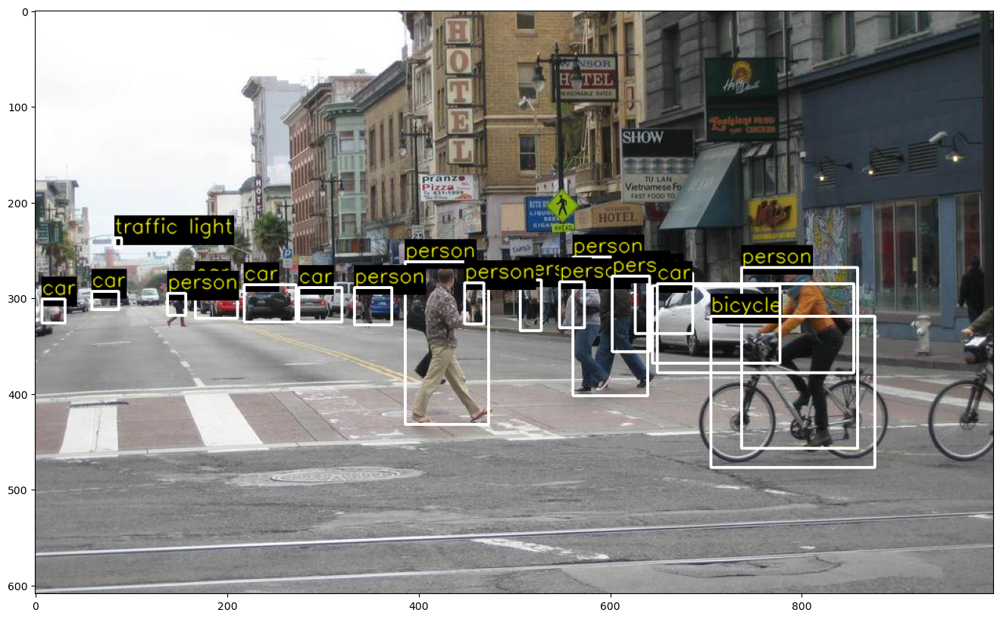

In [18]:
im = cv2.imread(os.path.join("images", "street.jpg"))
objects = detect_objects(net, im)
display_objects(im, objects)

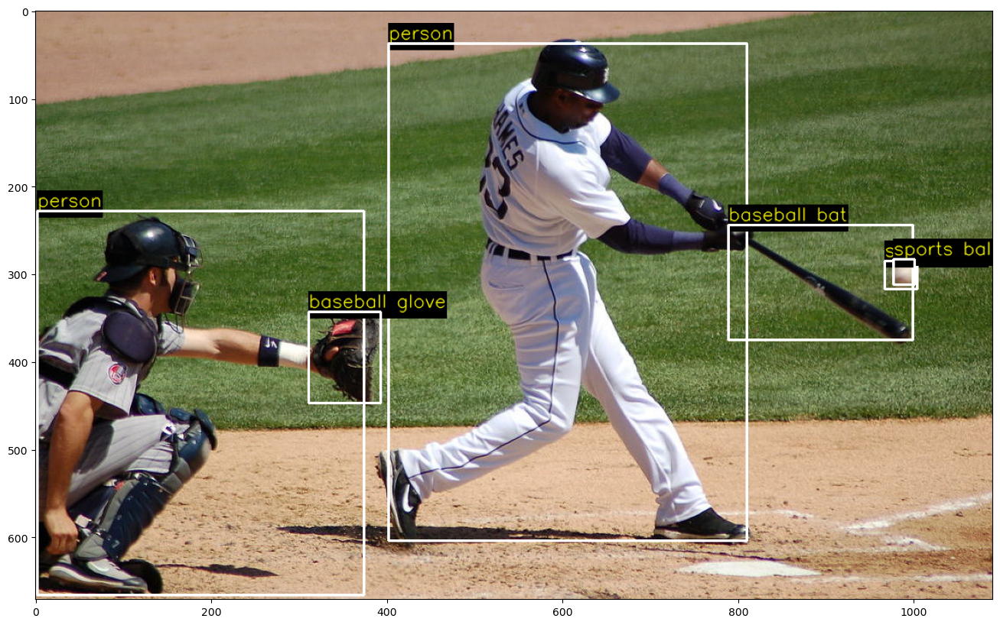

In [19]:
im = cv2.imread(os.path.join("images", "baseball.jpg"))
objects = detect_objects(net, im)
display_objects(im, objects, 0.2)

## Realtime Multi-Person 2D Pose Estimation using Part Affinity Fields (2017)

In [20]:
URL = r"https://www.dropbox.com/s/089r2yg6aao858l/opencv_bootcamp_assets_NB14.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB14.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

### Highlights
1. Train elsewhere, perform inference in an OpenCV application

2. Supports Caffe, Tensorflow, Torch and Darknet.

3. Supported layers : AbsVal, AveragePooling, BatchNormalization, Concatenation, Convolution (including dilated convolution), Crop, Deconvolution, DetectionOutput (SSD-specific layer), Dropout, Eltwise (+, *, max), Flatten, FullyConnected, LRN, LSTM, MaxPooling, MaxUnpooling, MVN, NormalizeBBox (SSD-specific layer), Padding, Permute, Power, PReLU (including ChannelPReLU with channel-specific slopes), PriorBox (SSD-specific layer), ReLU, RNN, Scale, Shift, Sigmoid, Slice, Softmax, Split, TanH

4. Use Caffe model trained on the Multi-Person Image Dataset (MPI) to demonstrate human pose estimation for a single person.

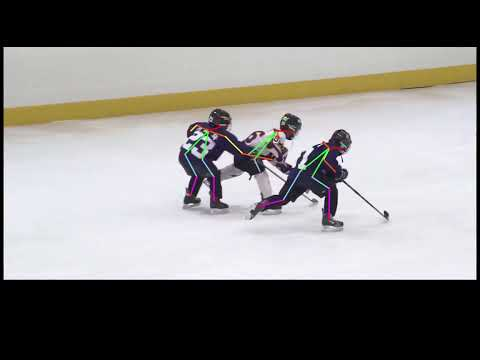

In [21]:
video = YouTubeVideo("RyCsSc_2ZEI", width=1024, height=640)
display(video)

## Load a Caffe Model
A typical Caffe Model has two files

1. Architecture : Defined in a .prototxt file
2. Weights : Defined in .caffemodel file

In [22]:
protoFile   = "pose_deploy_linevec_faster_4_stages.prototxt"
weightsFile = os.path.join("model", "pose_iter_160000.caffemodel")

In [23]:
nPoints = 15
POSE_PAIRS = [
    [0, 1],
    [1, 2],
    [2, 3],
    [3, 4],
    [1, 5],
    [5, 6],
    [6, 7],
    [1, 14],
    [14, 8],
    [8, 9],
    [9, 10],
    [14, 11],
    [11, 12],
    [12, 13],
]

net = cv2.dnn.readNetFromCaffe(protoFile, weightsFile)

### Read Image

In [24]:
im = cv2.imread("Tiger_Woods_crop.png")
im = cv2.cvtColor(im, cv2.COLOR_BGR2RGB)

inWidth  = im.shape[1]
inHeight = im.shape[0]

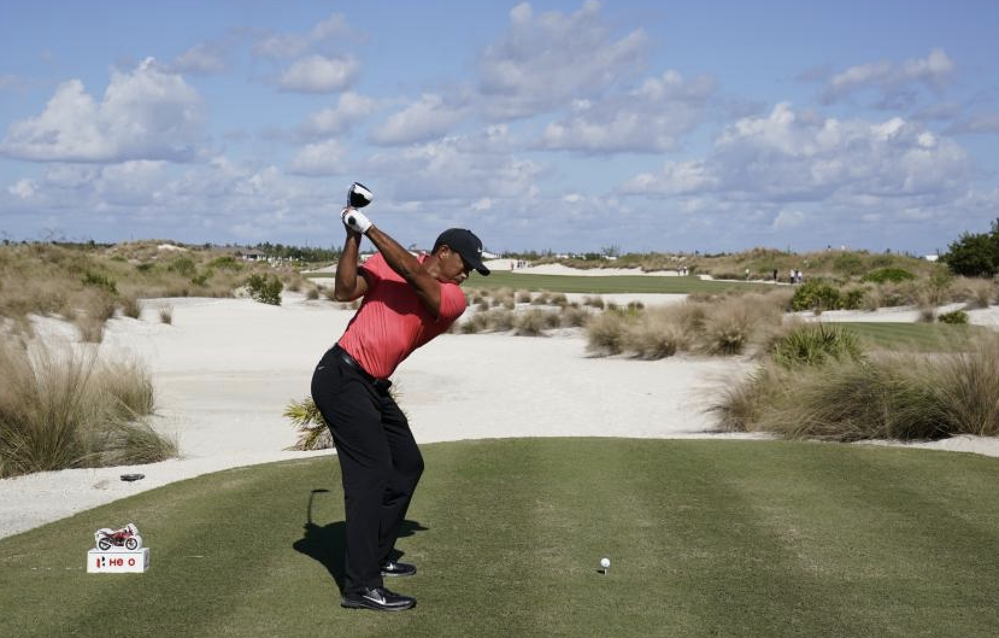

In [25]:
Image(filename="Tiger_Woods.png")

### Convert image to blob

In [26]:
netInputSize = (368, 368)
inpBlob = cv2.dnn.blobFromImage(im, 1.0 / 255, netInputSize, (0, 0, 0), swapRB=True, crop=False)
net.setInput(inpBlob)

### Run Inference (forward pass)

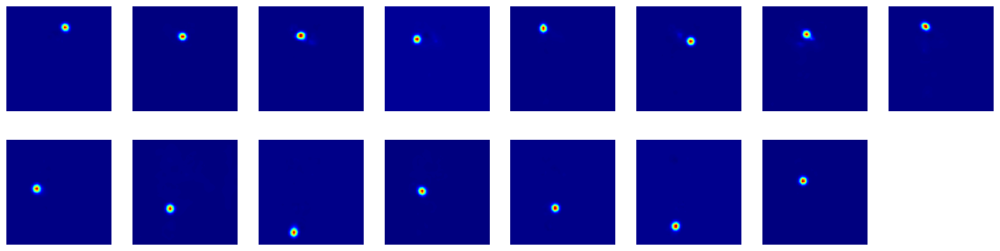

In [28]:
# forward
output = net.forward()

# Display probability map
plt.figure(figsize=(20,5))
for i in range(nPoints):
    propMap = output[0, i, :, :]
    displayMap = cv2.resize(propMap, (inWidth,inHeight), cv2.INTER_LINEAR)
    
    plt.subplot(2, 8, i+1)
    plt.axis("off")
    plt.imshow(displayMap, cmap="jet")

### Extract points

In [29]:
print(output)

[[[[-8.62051966e-05 -7.86171295e-05 -7.36315851e-05 ... -4.79728333e-05
    -4.76742862e-05 -2.92115146e-05]
   [-4.69283550e-05 -5.14576095e-05 -5.36361476e-05 ... -7.10345921e-05
    -7.32861809e-05 -4.55562840e-05]
   [-3.86602478e-05 -5.53761492e-05 -6.57568453e-05 ... -8.60335422e-05
    -1.00030913e-04 -7.01930840e-05]
   ...
   [-5.20375906e-05 -5.96999889e-05 -7.80734699e-05 ... -1.08561595e-04
    -8.49453500e-05 -7.68654281e-05]
   [-5.37893502e-05 -5.53069403e-05 -7.20091630e-05 ... -8.84436304e-05
    -7.69664184e-05 -8.28213524e-05]
   [-6.85858540e-05 -7.83039141e-05 -9.10321833e-05 ... -1.06773456e-04
    -1.14027411e-04 -9.16842837e-05]]

  [[-1.38489559e-04 -1.37995899e-04 -1.47402490e-04 ... -1.33889116e-04
    -1.25011255e-04 -9.73646602e-05]
   [-1.25676102e-04 -1.28542742e-04 -1.30931556e-04 ... -1.52524211e-04
    -1.54060515e-04 -1.30596774e-04]
   [-1.16643270e-04 -1.35519687e-04 -1.36871502e-04 ... -1.46819890e-04
    -1.59579417e-04 -1.39210286e-04]
   ...
   

In [30]:
# X and Y Scale
scaleX = inWidth  / output.shape[3]
scaleY = inHeight / output.shape[2]

# Empty list to store the detected keypoints
points = []

# Treshold
threshold = 0.1

for i in range(nPoints):
    # Obtain probability map
    probMap = output[0, i, :, :]

    # Find global maxima of the probMap.
    minVal, prob, minLoc, point = cv2.minMaxLoc(probMap)

    # Scale the point to fit on the original image
    x = scaleX * point[0]
    y = scaleY * point[1]

    if prob > threshold:
        # Add the point to the list if the probability is greater than the threshold
        points.append((int(x), int(y)))
    else:
        points.append(None)

### Display Points & Skeleton

In [31]:
imPoints = im.copy()
imSkeleton = im.copy()

# Draw points
for i, p in enumerate(points):
    cv2.circle(imPoints, p, 8, (255,255,0), thickness=-1, lineType=cv2.FILLED)
    cv2.putText(imPoints, "{}".format(i), p, cv2.FONT_HERSHEY_SIMPLEX, 1, (255,0,0), 2, lineType=cv2.LINE_AA)

# Draw skeleton
for pair in POSE_PAIRS:
    partA = pair[0]
    partB = pair[1]
    
    if points[partA] and points[partB]:
        cv2.line(imSkeleton, points[partA], points[partB], (255, 255, 0), 2)
        cv2.circle(imSkeleton, points[partA], 8, (255,0,0), thickness=-1, lineType = cv2.FILLED)

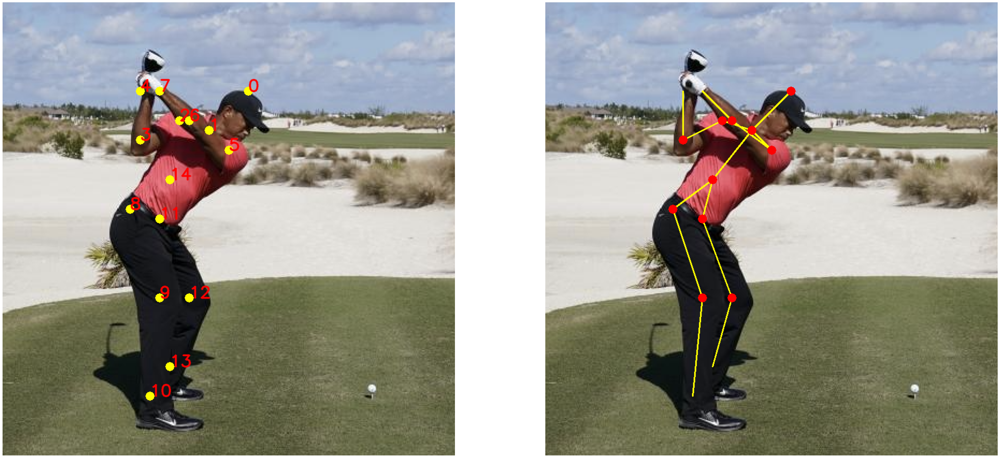

In [32]:
plt.figure(figsize=(50, 50))

plt.subplot(121)
plt.axis("off")
plt.imshow(imPoints)

plt.subplot(122)
plt.axis("off")
plt.imshow(imSkeleton)